## T54 - Ensemble Techniques


Ensemble - Combining Multiple Models . There are two types of Techniques in Ensemble

1. BAGGING (BOOTSTRAP Aggregation)

* Random Forest

2. BOOSTING

* AdaBoost
* GradientBoost
* XGBoost

### 1. BAGGING (Bootstrap Aggregation) - Ensemble Technique

If we have a complete Dataset of D (n records) , In Baagging Multiple Models are created (M1,M2,M3...MK). \ 
Now each and every model will be provided a sample of data D1 (m records) - M1 ,Again Re sample Data and provide  D2(m records)-M2 model , Similarly we will do for all other models. These process is called Row sample with Replacement 

m records < n records

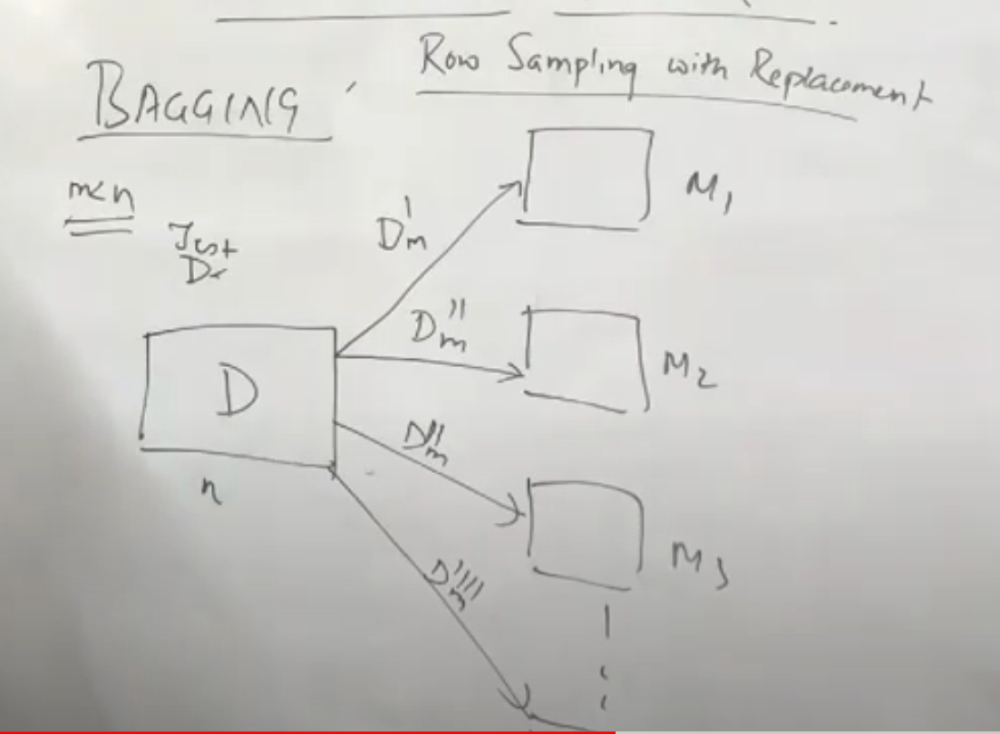

Now each and every model will get trained on the sample of data which has been provided to them.Now whenever Test data is feed in,it goes to each and every model, And each model will give its output .

Once All models (M1,M2,M3..) has provided output , voting classifier is used - Majority of the votes will be considered as Winner.

Bootstraping is process in which we take sample of data and provide it to model using Row sampling with Replacement method
At last we do aggregation of votes to get winner

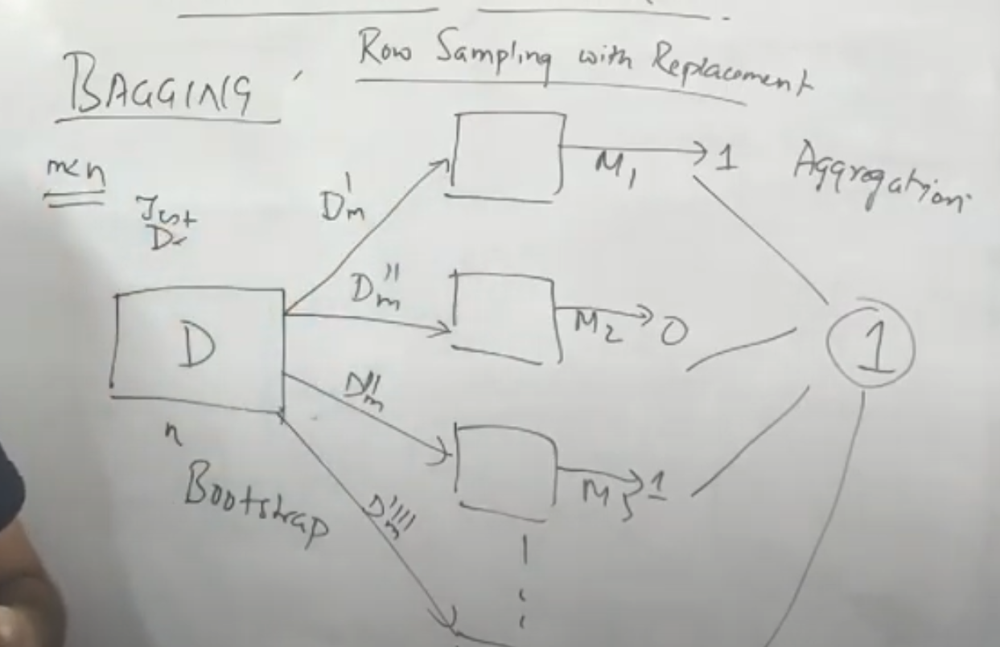

## T55 - Random Forest Classifier and Regressor (Bagging or Bootstrap Aggregation method)

As we know that in Ensemble , various baseline models are used, In Random forest - Decision Tree model is used .

#### Random Forest 

From Dataset that we have , First we will select Sample of Rows , Sample of Columns(Features) - So both are used Row Sampling with Replacement and Column Sampling with Replacement - Give these to DT-1 (Decision tree)

Now For Second DT2 - We will again do Row Sampling,Column Sampling  (Some records of First DT1 sample can get repeat over here)
Will do these process , For all DT models.

Once All DT models will get trained on its sample , And now When test data is provided , Each DT model will give its output .Once every model has given its output , Voting classifier is used to find the winner among the output.

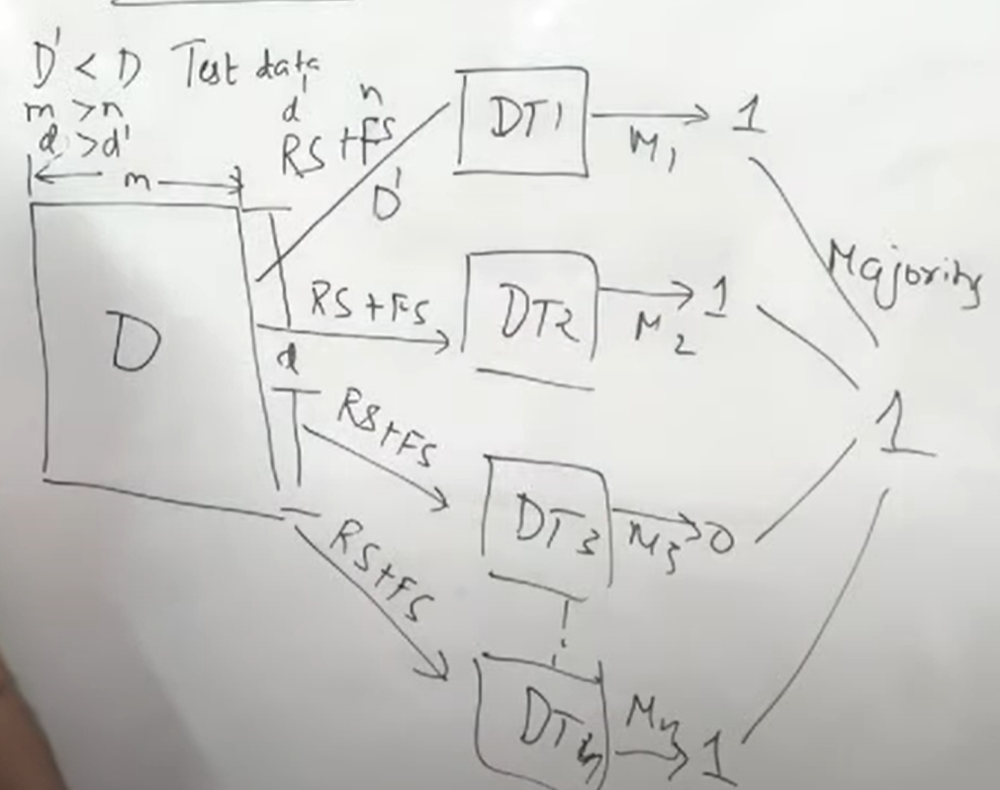

When Decision Tree is splitted to its complete Dept it has Low Bias and High Variance (Training error rate is less but testing error rate is high)- Overfitting.

When Multiple Decision trees are used , Output gets converted to Low Bias and Low Variance

Random Forest gives better accuracy , It works really well for most of Machine Learning use cases.


Support if it is a Regresssion Problem , Then every DT model will give continous value , We will take mean of all these values to get our Final Continous value

## T58 - Boosting Techniques - AdaBoosting

In Boosting Techiniques , Baseline Models are created Sequentially

If we have a Dataset D,Records will get passed to BaseLearner Model (BL1) .BaseLearnerModel can be any model.Now once it is trained .
Now the Records which are not correctly classified by (BL1) only these records will get passed to 2nd BaseLearnerModel (BL2). \
Out of  the Records given to BL2 , records which are not correclty classified will get passed to 3rd BaseLearnerModel (BL3). \

Now these process will continue untill the limit of BaseLearner models we specified

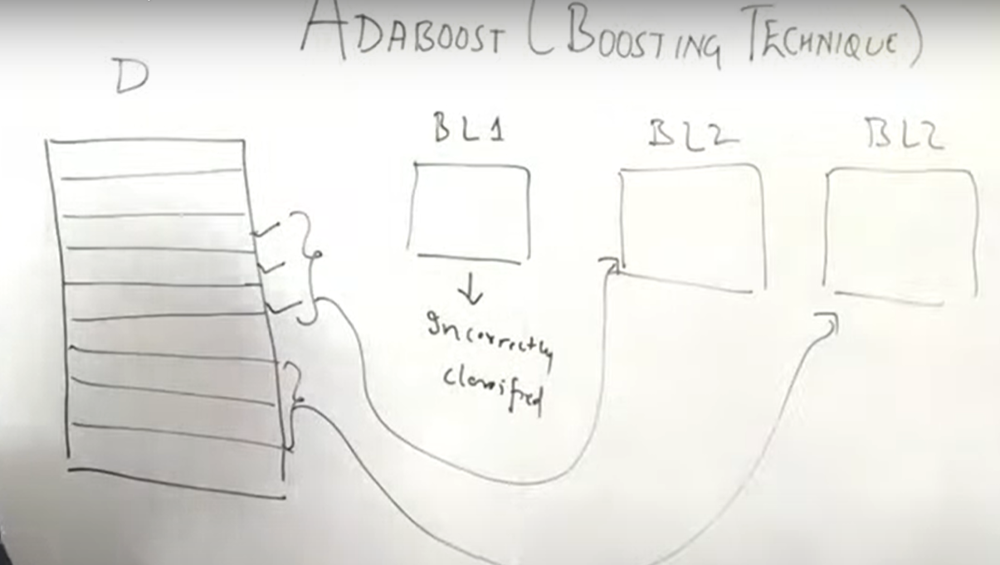

### AdaBoosting

Now in AdaBoosting , Lets consider we have dataset with 3 features (f1,f2,f3) , There are 7 records.

#### Step 1

Now each and every record will get SAMPLE WEIGHTS .Formula for Sample weights = w = 1/n = 1/7 . So initially all records are assigned same weight

#### Step 2

Now we will create our first BaseLearner(Decision Tree) . Here Decision tree is created with only One Depth
STOMPS - These Decision tree are called stomps

So for each and every feature STOMPS are created. So Three STOMPS are created .

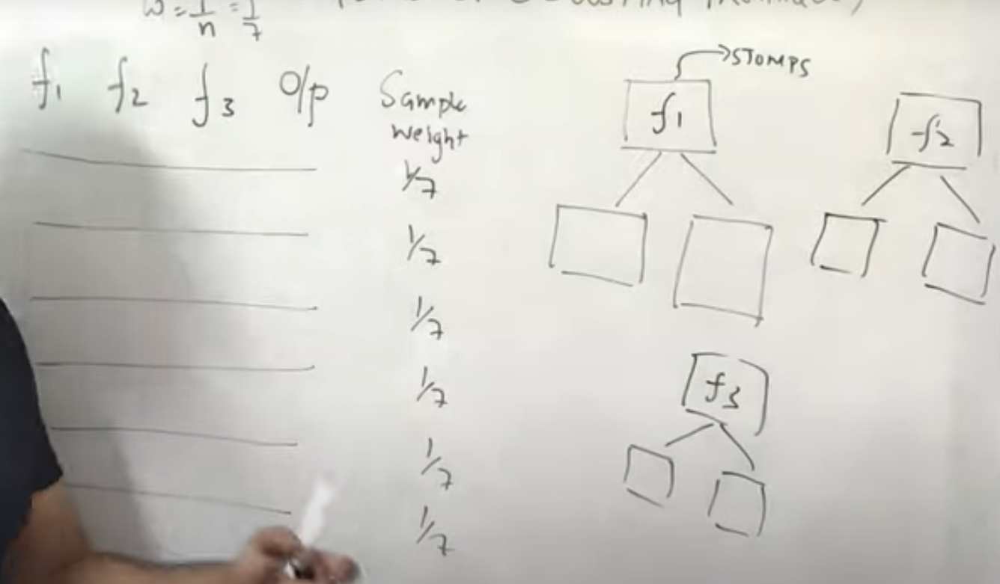

But From these particular STOMPS , We will have to select 1st Decision Tree BaseLearner model. So for selecting the best from these STOMPS , We use Entropy OR Ginni coefficient .

Whichever stomp has lesser Entropy or Ginni coefficient , We will select that Decision Tree BaseLearner Model

### Step 3

Once we select Decision tree for BaseLearnerModel , Suppose We selected Decision tree (Stomp) of f1 .Suppose these decision tree has correctly classified 4 Records and uncorreactly classified only 1 record. So for these incorrectly classification we will find Total Error - We calculate total error by Summing up all Sample weights of Incorreclty classified records

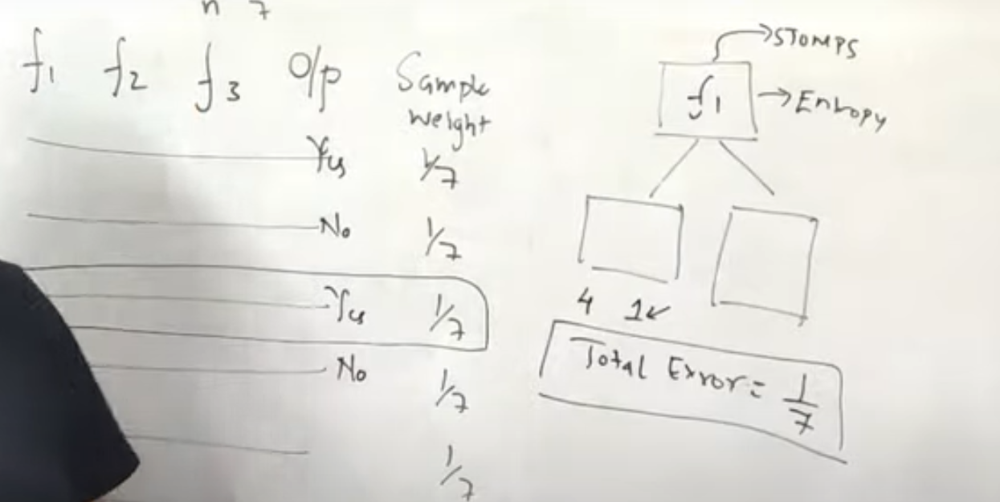

### Step 4

Now we already have total error - TE \
Now we will try to find performance of STOMP.Peformance formula is given below

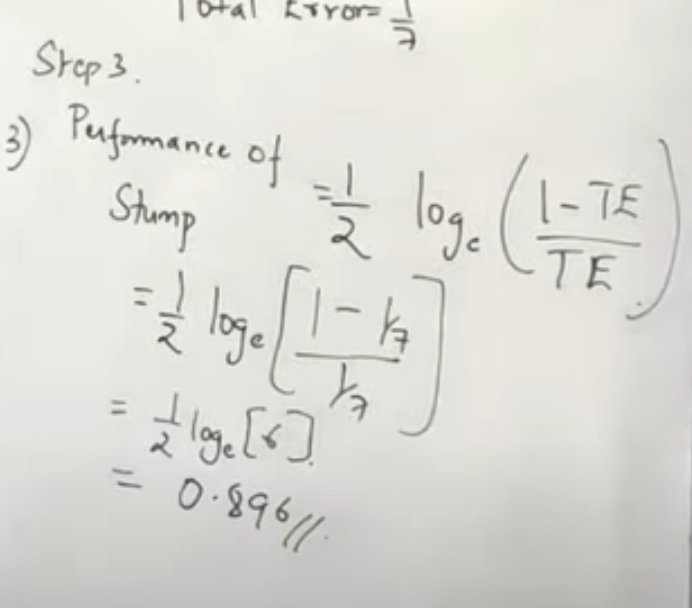

### Step 5

Once we have find out Total Error and Performance of Stomp , We need to update Weights . \ 
Now as we know only Incorreclty classified records are passed to the Next BaseLearner Model in Boosting Techniques. \
So before that we will increase weights of wrong classified records  , Decrease weights for correctly classified records.So based on that weights will be updated via Peformance of Stomp that we found in Step4

#### Weights Updation formula for Incorreclty classified records

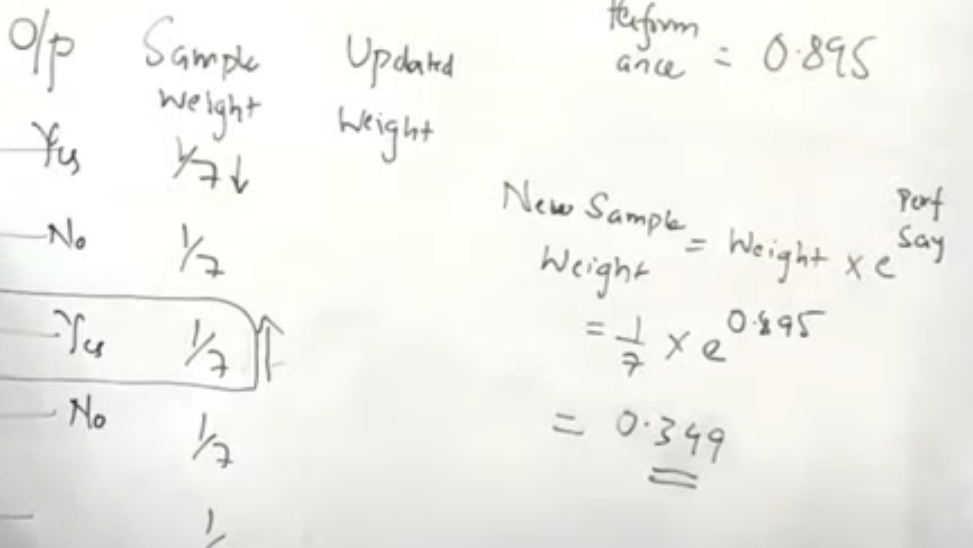 

#### Weights Updation formula for Correclty Classified records

Only one little change in Formula instead of +ve we will do -ve sign

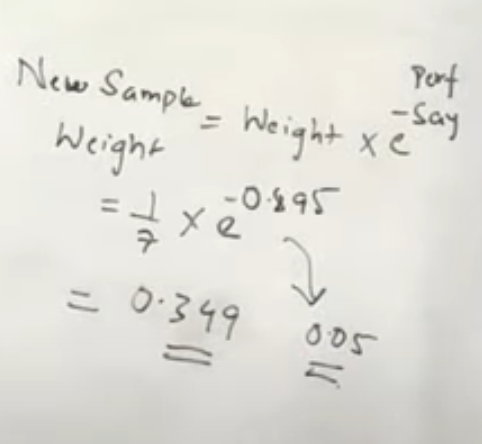

### Step 6

Since all these values when added they are not giving value = 1
So for that we will Divide each and every updated weights value by (Total of Updated Weights) = 0.68
i-e Each value will be divided by 0.68 ----- Normalization .

In below example you can see that , 2nd record was not correclty classified , Therefore its weight got increased

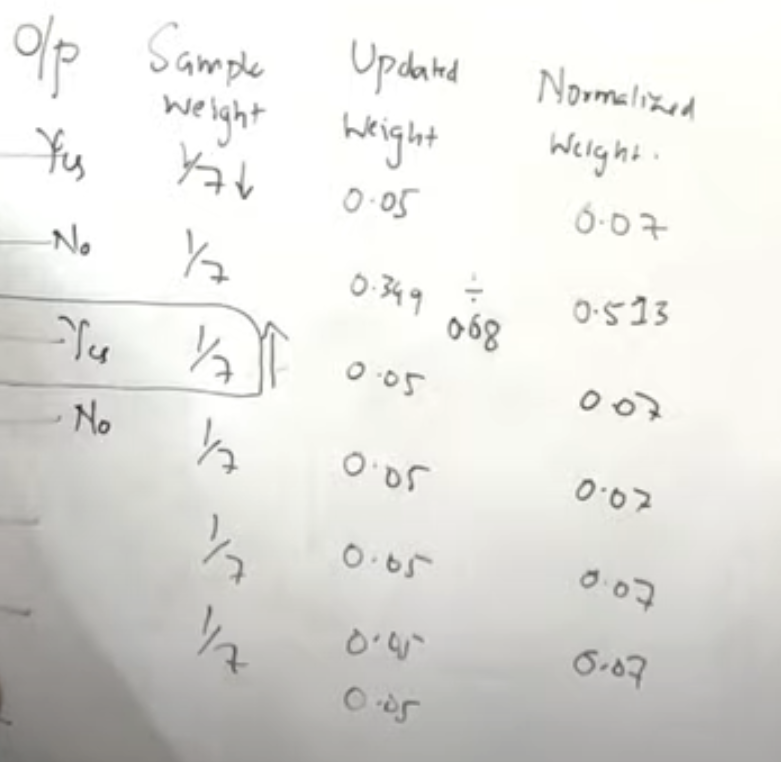

### Step 7

Considering these Normalized weights we will create new dataset

Based on Normalized weights we will divide them Into Buckets . Now our algorithm will run N iterations . \
On each iteration, it will calculate a random number ranging between 0-1 and this random will be compared with class intervals we created and on which class interval it lies, that row will be selected for sample data set. So new sample data set would also be of N observation

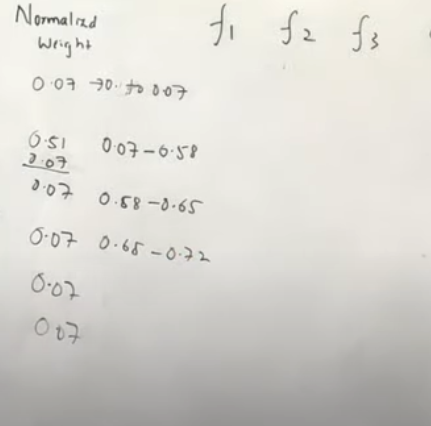

For Example - In 1st iteration , random number selected is 0.43 . Now it will go and see in which bucket it lies . And corresponding record will be selected for Dataset for 2nd BaseLearner Model.Most likely recordss wwhich are wrongly classified by BaseLearner 1 will be selecteed . But it can contain other records as well.

### Step 8

Now based on these new dataset , New Stomps will be created , One Stomp will get selected , it Peformance and Total Error will be calculated , Weights wil get updated , Normalization of Weights will be Done, Based on these normalized weights again Buckets will be created to get new sample dataset for 3rd BaseLearner Model

So based on our original dataset , We got our Decision trees for BaseLearnerModels . Now we will do classification for our Test Data, Each BaseLearner Model will give its Ouput, Voters algorithm will be used to identify which is the majority of vote ..

So Basically we are combining WEAK Learners to get STRONG LEARNER

## Summary

This method does not follow Bootstrapping. However, it will create different decision trees with a single split (one depth), called decision stumps. 
The number of decision stumps it will make will depend on the number of features in the dataset. Suppose there are M features then, Adaboost will create M  decision stumps. 
1.  We will assign an equal sample weight to each observation. 
2. We will create M decision stumps, for M number of features.
3. Out of all M decision stumps, I first have to select one best decision tree model. For selecting it,we will either calculate    the Entropy or Gini coefficient. The model with lesser entropy will be selected (means model that is less disordered).
4. Now, after the first decision stump is built, an algorithm would evaluate this decision and check how many observations the    model has misclassified.
5. Suppose out of N observations, The first decision stump has misclassified T number of observations.
6. For this, we will calculate the total error (TE), which is equal to T/N.
7. Now we will calculate the performance of the first decision stump.
   Performance of stump = 1/2*loge((1-TE)/TE)
8. Now we will update the weights assigned before. To do this, we will first update the weights of those observations, which we    have misclassified. The weights of wrongly classified observations will be increased and the weights of correctly classified    weights will be reduced.
9. By using this formula for incorrect classification: old weight * ^e performance of stomp 
   For corrrect classification : old weight * e ^- performance of stomp
10. Now respectively for each observation, we will add and subtract the updated weights to get the final weights. 
11. But these weights are not normalized that is their sum is not equal to one. To do this, we will sum them and divide each       final weight with that sum. 
12. After this, we have to make our second decision stump. For this, we will make a class intervals for the normalized weights.
13. After that, we want to make a second weak model. But to do that, we need a sample dataset on which the second weak model       can be run. For making it, we will run N number of iterations. On each iteration, it will calculate a random number ranging     between 0-1 and this random will be compared with class intervals we created and on which class interval it lies, that row     will be selected for sample data set. So new sample data set would also be of N observation. 
14. This whole process will continue for M decision stumps. The final sequential tree would be considered as the final tree.

## T59 - Gradient Boosting - Part 1 -- w.r.t  Regression

Dataset contains Experience and Degree as Independent features , Salary has Dependent Features

### Step 1

Now we will compute BaseModel which will give me one output - Output will be the average of All output in Dataset - 75 

### Step 2

Now we will compute Residuals (Errors/Psuedo Residuals) by using Loss Functions .Now we will just assume simple Loss Function of (actual value - predicted value)

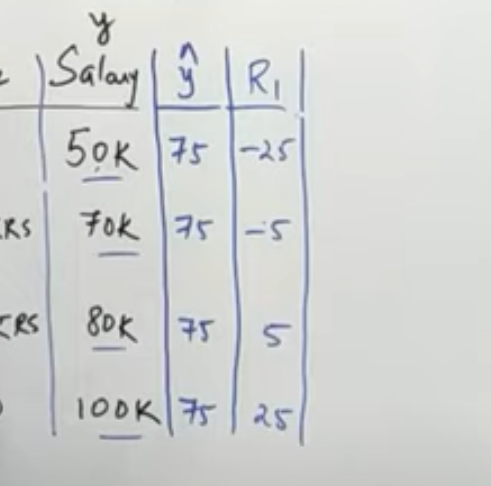

### Step 3

Now we will construct Decision Tree, with Input (Experience, Degree) , Output Value will be Residual/Error/Psuedo Residual.
Decision tree will get Trained on data to predict output as Residuals . So again we will pass independent features to get output from Decision tree as Residuls2 (R2)

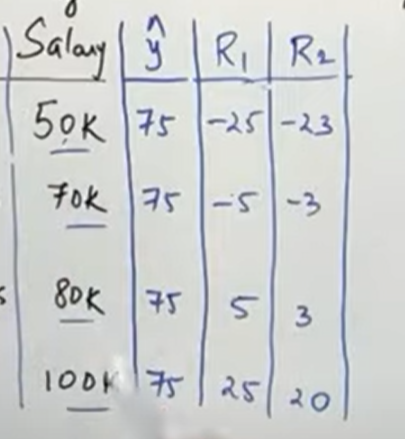

### Step 4

Now we will Compute Salary -  So now we pass our Input Features (Experience,Degree) to our Base Model(Aggregation model) and Decision tree model (DT1) . These two models are attached Sequentially .

So When we pass Input to our Base model we will get output as aggregated value = 75
Now when these Input(Experience,Age) is passed to Decision tree we will get Residual value = -23 

75-23 = 52

So we have seen that Actual salary is 50K and we got value as 52k . Model is performing better ?
No Model is not performing better - OVERFITTING 

So to overcome these , We will add learning rate in formula .

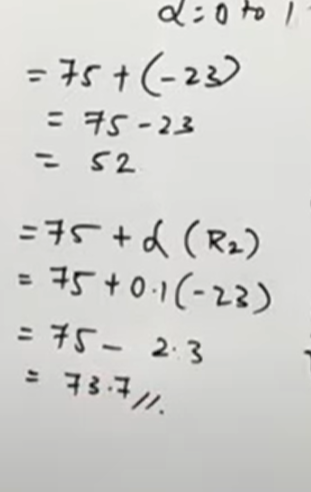

## Step 5

Then to we have Large difference between Salary and Predicted value .

So again we will add Decision tree model again .These Decision tree model will be created based on R2 value and Independent Features(Experience,Degree)

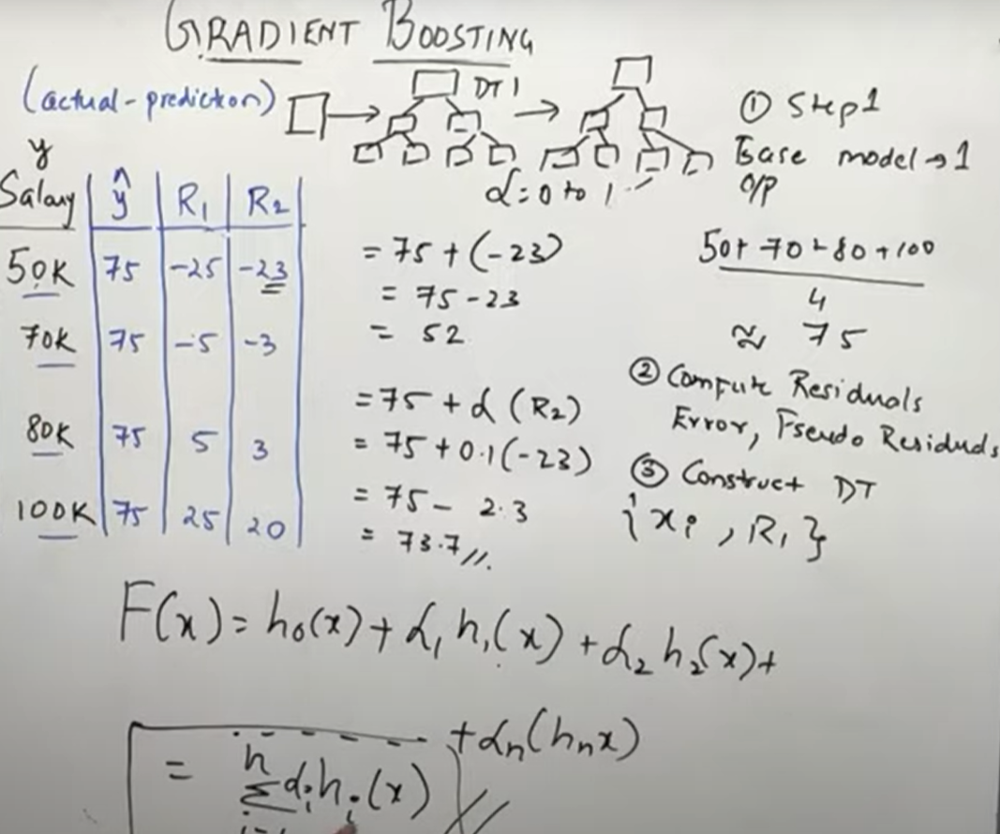

In these we are creating multiple Decision tree sequentially after base model . So After each decicison tree Residual Error will get reduced . Aim to Reduce the Residual error.

So whenever new test data come , It will pass through Base model ,DT's which are sequentiall arranged

## T60 -  Gradient Boosting - Part 2  - Maths Inutition

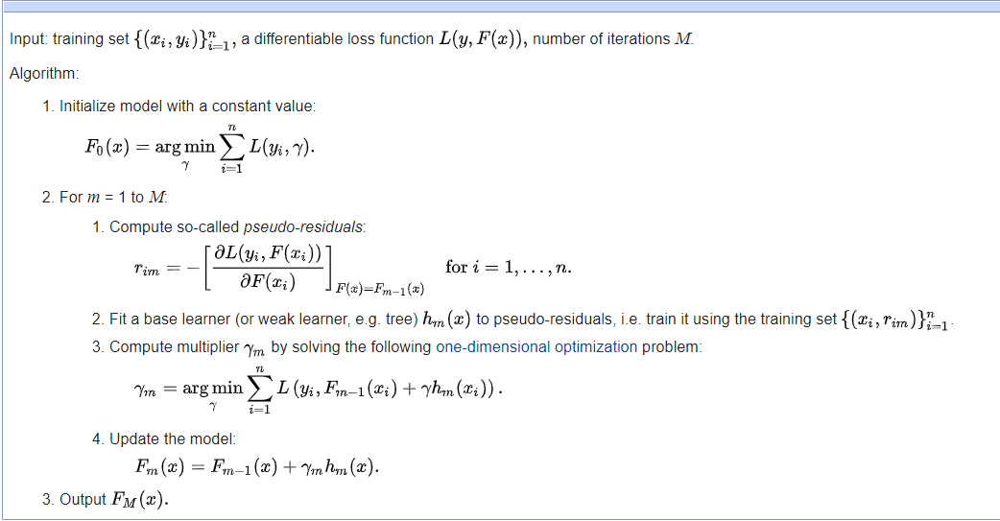

#### Inputs to our Function

1. Experience , Degree = Independent Features , Salary - Dependent Feature
2. Loss Function  (MSE,RMSE..) w.r.t Regression (To calculate Residuals - R1)
3. No of trees

### Algorithm

#### Step 1 : Initialize Model with Constant values  .

In Inutition we created Base Model (Which was used to predict the Aggregation value ). But now we will use these formula to obtain the output for BaseModel

We need to find out Y(hat) or predicted value in such a way that Loss Function should be minimum.

So we should get minimial Error

L(Y,GAMMA)

Gammma - Predicted value , L - Loss function 

Loss Function 

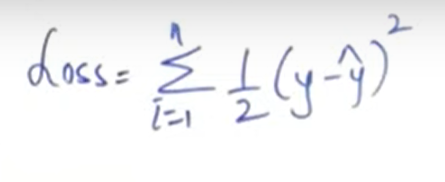

##### Now in order to find out predicted value we will do First order derivative

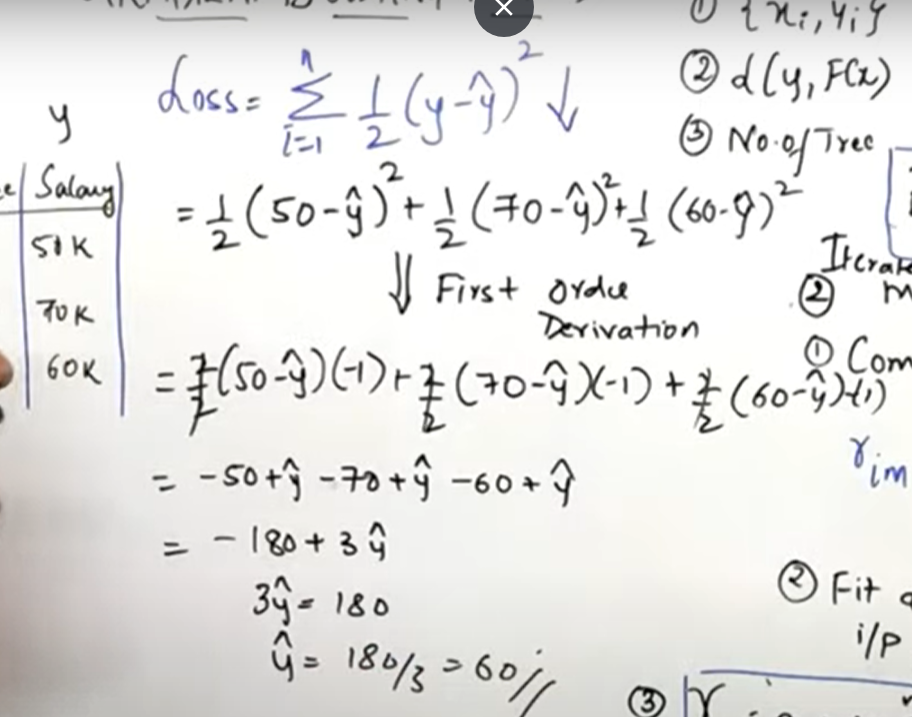

So now we got our Constant value i-e Y(hat)/Predicted value = 60

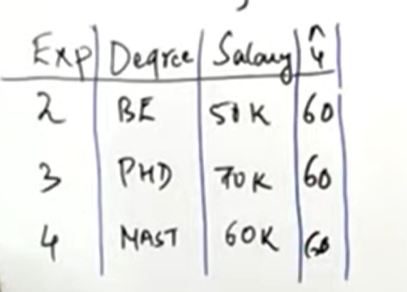

### Step 2

Now we iterate this from 1 to M ----- i-e From 1 to No of trees

Now we will calculate Residual 1 - R1 (From Above Intuition part1 we know that it is actual value - predicted value

Now in Each Iteration we will compute Psuedo Residuals , Based on Formula Given in algo

Derivative of Loss(y,f(x0)) ------ x0 We calculated 

###### FOR R1  -- Iteration step 1

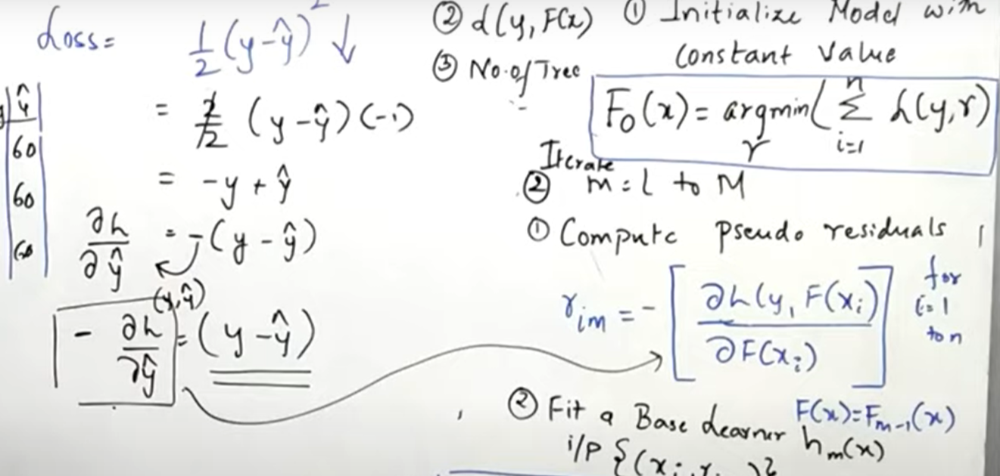

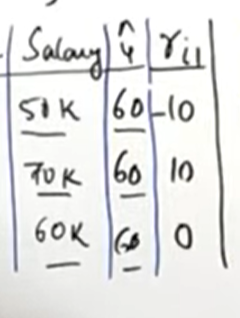

#### Iteration - Step 2

Now once R1 is calculate from step1 iteration , We will go to BaseLearnerModel(DT1) which will have \
Independent Features -- (Experience,Degree) , Dependent Feature - (R1)


#### Iteration - Step 3

Now we have to find the gamma which will minimize the Loss of DT(1) OR previous BaseLearner model. 
Our Main step1 value will also get added over here and then we will do First Order Derivative

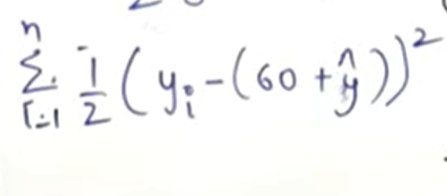

#### Iteration - Step 4

Update Model -- Based on y predicted value and Residual value .

If there is a huge difference , Then Again new DT(2) will be created

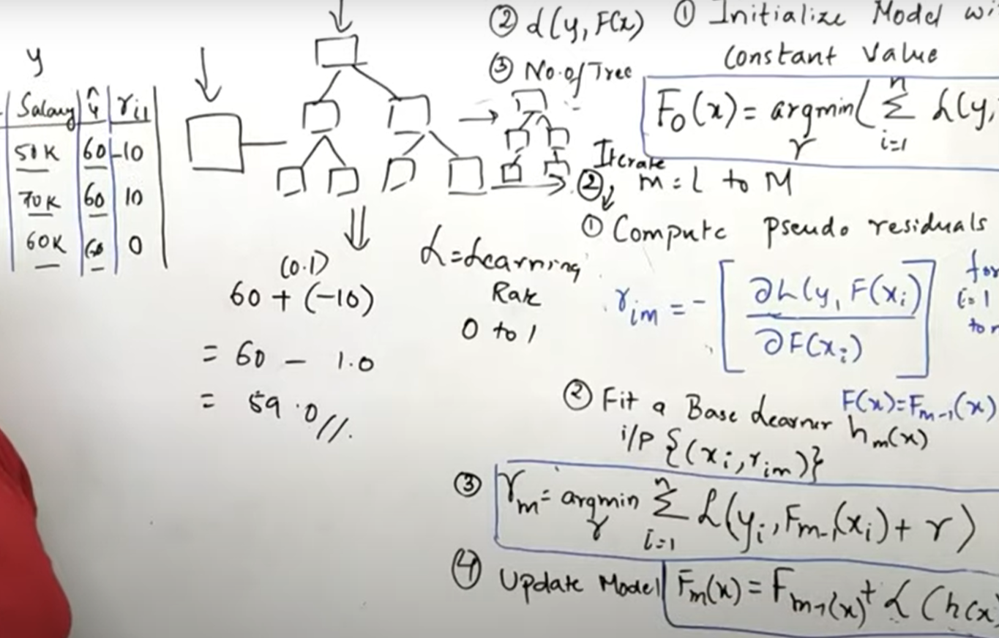

## T61 - XgBoost Classification Intuition - Part 1

### Extreme Gradient Boosting

Based on Salary and Credit Score , We will see whether bank will approve your LoanApplication or not 

### Step 1

First we will create BaseLine Model -- Similar to Gradient Boosting we will take Average -- Probability =  0.5
Now we will calculate Residuals (Actual Value - Probability) = (0-0.5) = -0.5 = (1-0.5) = 0.5

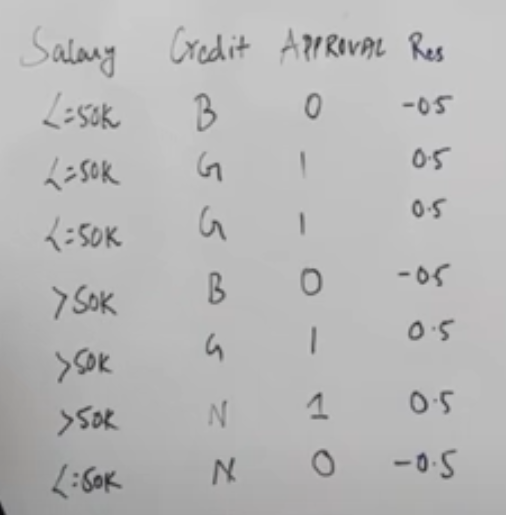

### Step 2

Now we will start constructing Decision Tree.Based on Feature 'Salary' and 'Residual Value'

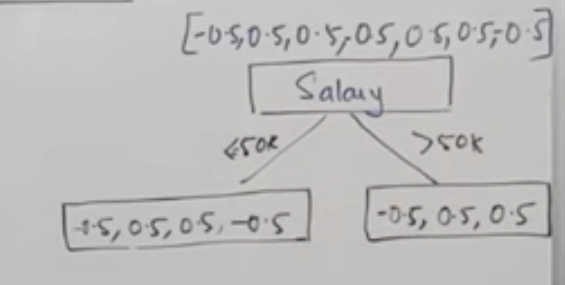

### Step 3

Now we will calculate Similarity Weight and Information Gain for Above Decision Tree

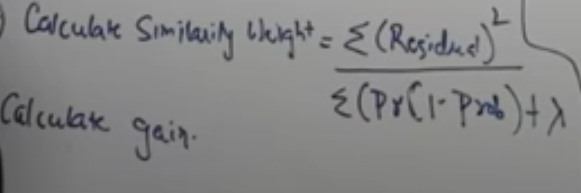

We will get Similarity weight for <=50k

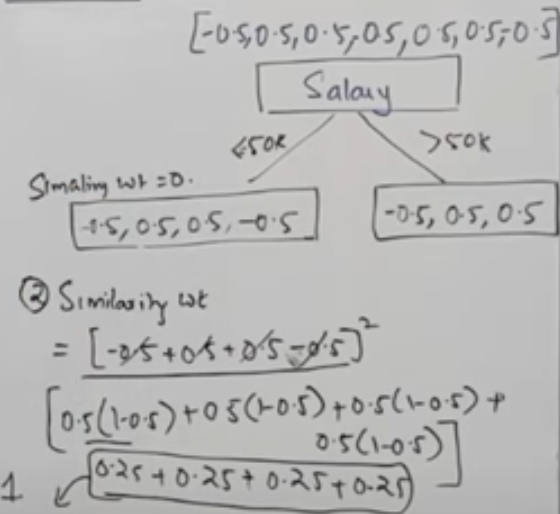

Similarity weight for >50k

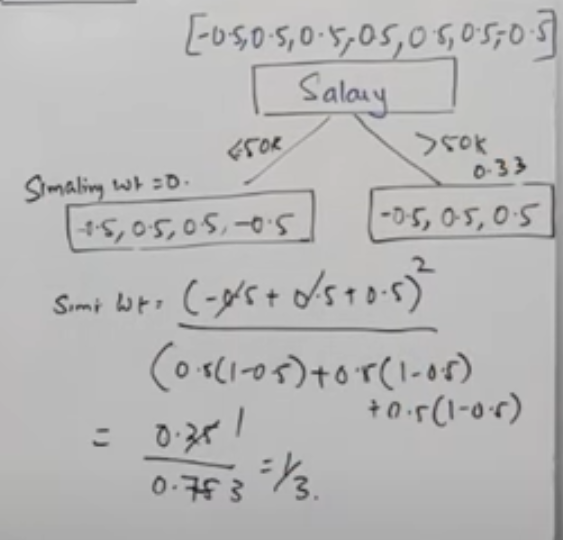

Similarit Weight for Root Node = 0.14

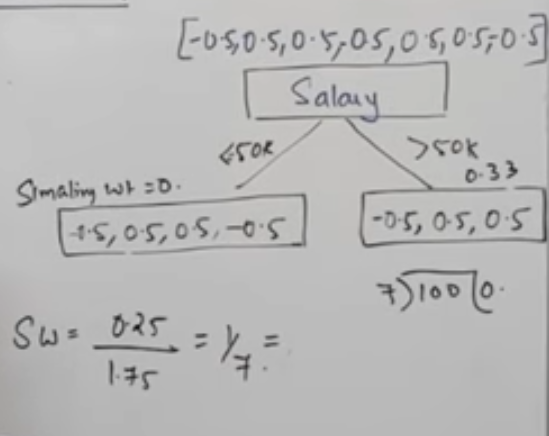

#### Now we will calculate Gain (Sum of Similarity Weights)

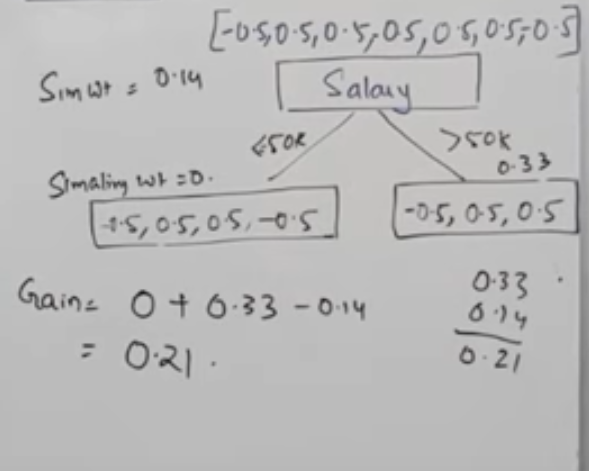

### Now we will do same splitting process in Credit Score Feature 

Where we will calculate Similarity Weight and then Gain. And then we found out that Gain of Salary is Highesh .So we will stick with these Decision tree where Salary is Root Node.

### Now we do splitting process of our Selected Decision tree further

For Further splitting , We will go in depth by taking Credit Score Feature , Now when salary <=50 we will see the credit score value,Residual value to calculate Similarity weight . Credit Score Contains Three Cateogries (B,G,N).Now we will see Information gain of both the tree and see whichever is higher , Here both are equal so we will only take 1

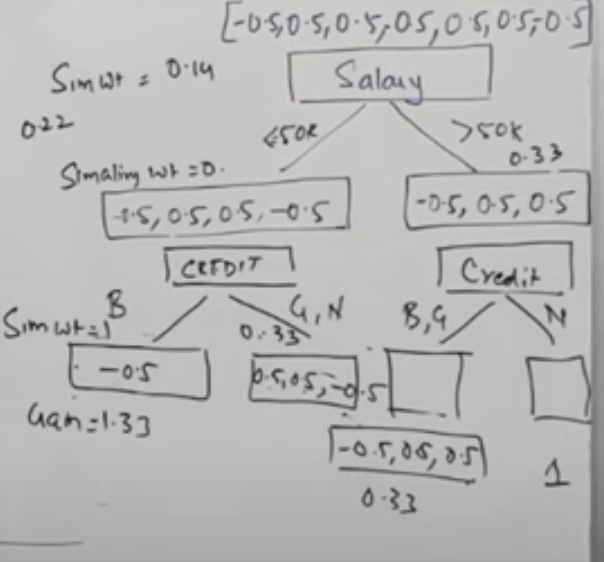

### Step 4

##### Now once we got our Final Optimized Decision Tree , We will check whether we have to do further splitting or not

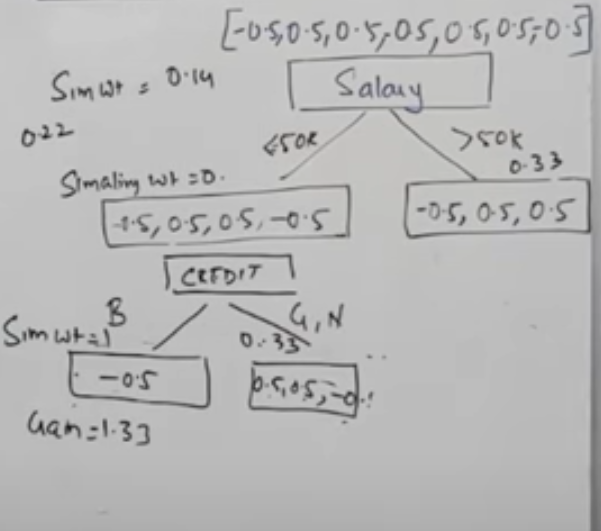

Now question rises that whether we should do splitting in G and N  ---- Can be Done via 

#### POST-PRUNNING

Post prunning in XGBoost is calculate by cover value.

Probability * ( 1 - prob) = 0.25 

So whenever my Gain value is < 0.25 , We will cut that branch.


Whole Decision Tree

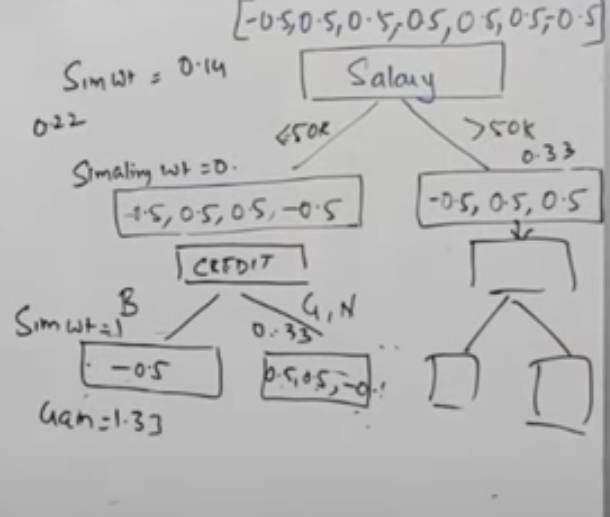

####  Similarly many Decision trees will be constructed , once we calculate residuals

### Test Data 

Salary <=50k , Credit Score - B 

First We will find BaseModel output w.r.t probability = 0.5 as we have taken earlier

#### Base Model Formula to get Output 

log((0.5/0.5)) = log(1) = 0 . These Base Model will give output 0

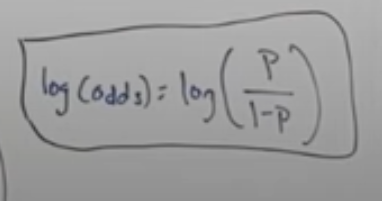

#### TEST DATA 

So when we follow DT1 with Salary <=50k , Credit = B ,  we are getting Similarity Weight as 1

So with Base Model Output , Similarity Weight = 1 , Learning rate  , Sigmoid Activation Function we will get final output


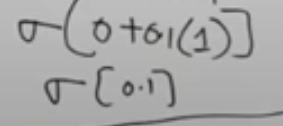

So when we calculate Sigmoid Function with 0.1 , If we get 0.6 

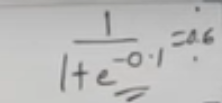

### STEP 5

Similarly we will calculate for all other 
Now we will get our new Residuals

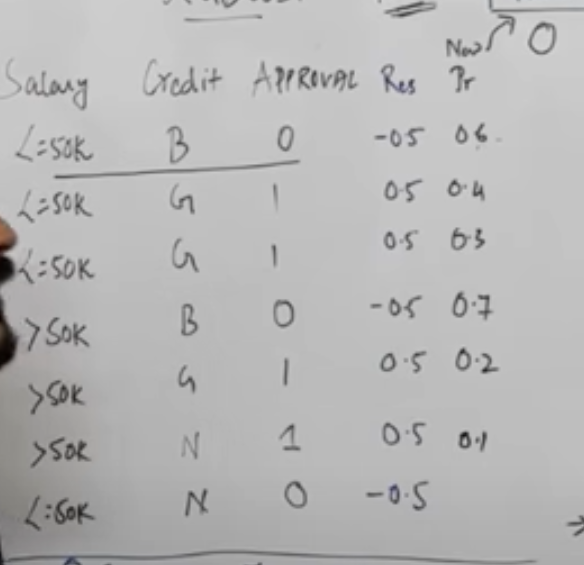

### Now again Based on these Probability we will calculate our new Residual

Change in Below Image  , We will get these residuals 
(0-0.6) = -0.6 \
(1 -0.4) = 0.6 \
(1 -0.3) = 0.7 \
(0 - 0.7) = -0.7 \
(1 - 0.2) = 0.8 \
(1-0.1) = 0.9 \

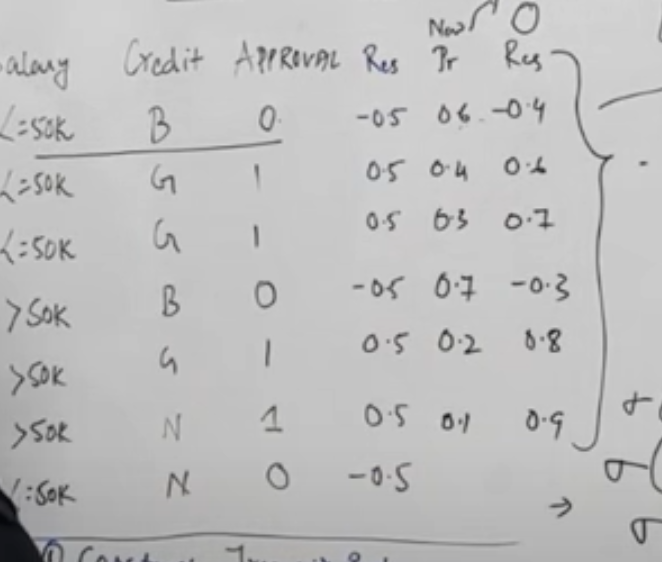

Now again we will contruct new decision tree , Again we will do splitting , similarity weight,gain,calculate Probability,New Residual etc......



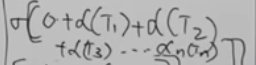

## T62 - XGBoost Regressor - Part2


#### Dataset

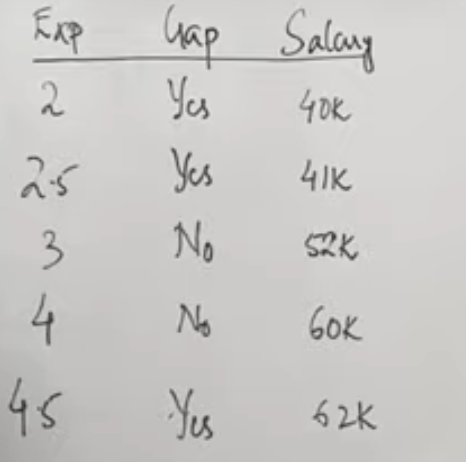

### Step 1

First we need to construct Model - These Model will take Aggregation of Values of Salary to give output

Average Salary = 51K .


### Step 2

Now we will calculate Residual . Decision Tree will get trained on these residual value

(40-51) = -11
(42-51) = -10 

Small change in dataset , instead of 41 in row2 we will write 42

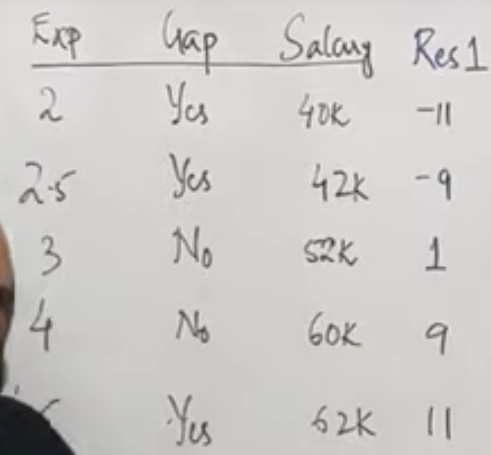

### Step 3

Now we will create Decision with Indpendent Features - Exp,Gap , Dependent Feature - Residual1

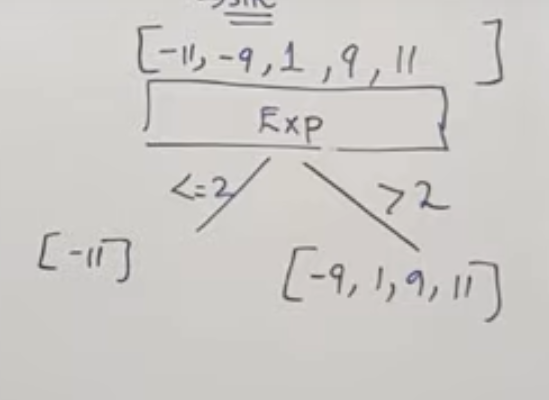

### Step 4

Now we will calculate Similarity Weight and Gain

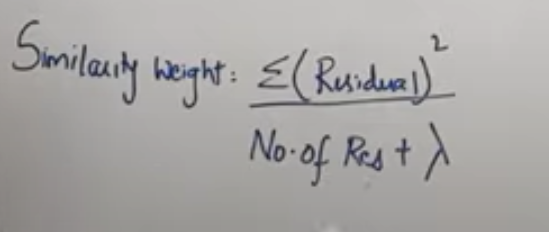

Instead of 65.5 it will be 60.5

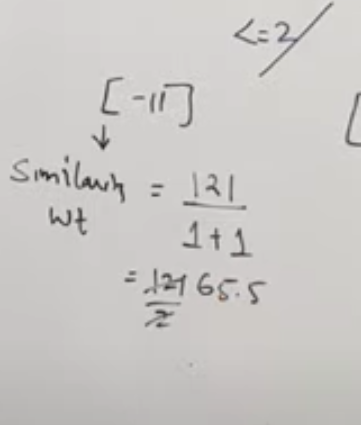

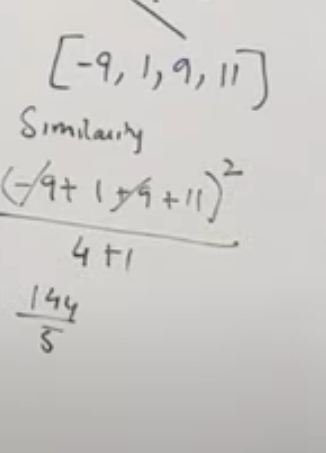

#### Now once we calculate Similarity weight of root , we will calculate Gain

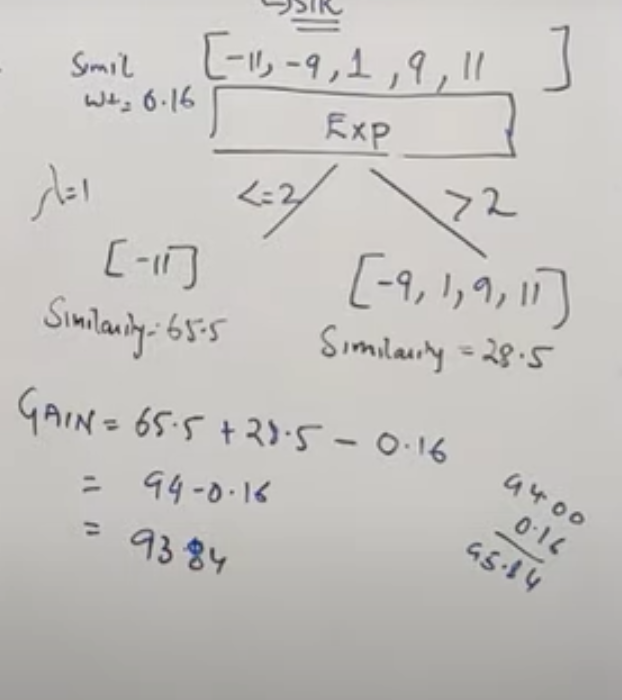

#### Step 5

Similarly we will calculate Gain for 2nd Records as well and compare it with first one i-e 93.84 (Correction in below image)

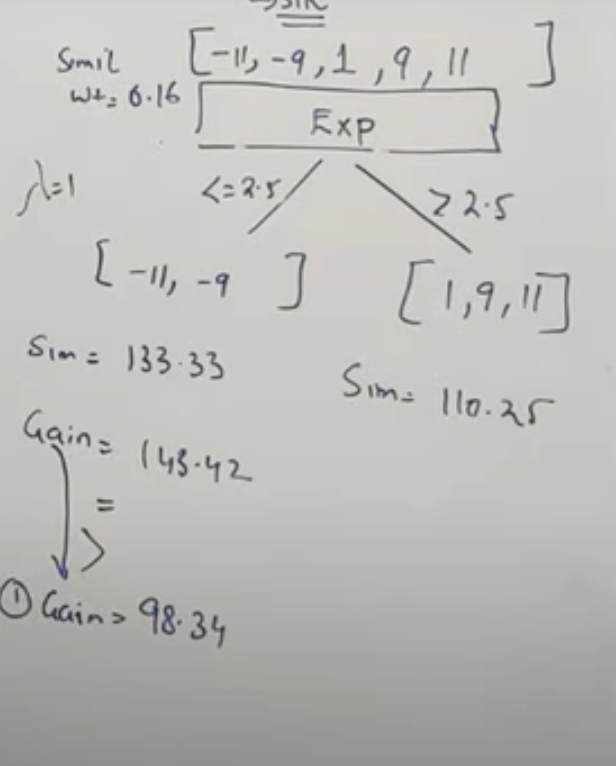

### Step 6

Now once we have decided that we will keep these Gain (143.42) DT we will take another feature and do the Splitting again to create final DT

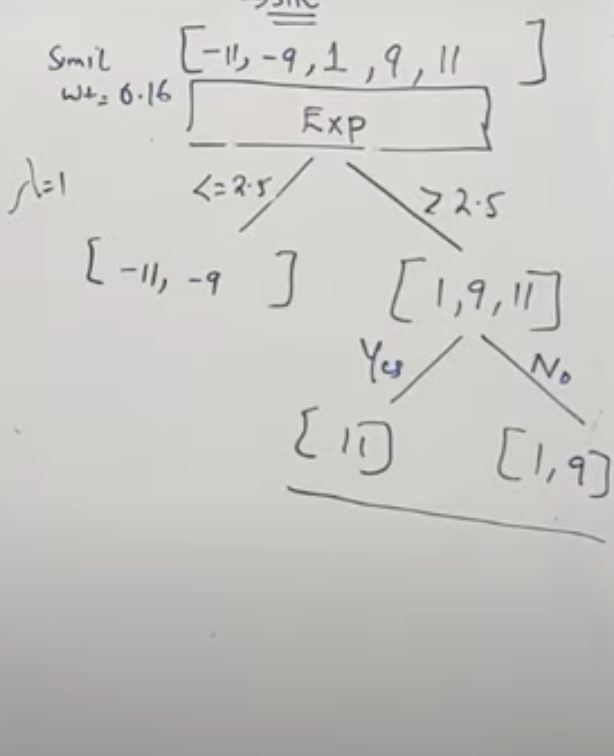

### Step 7

To calculate output we will take Average of values in leaf nodes

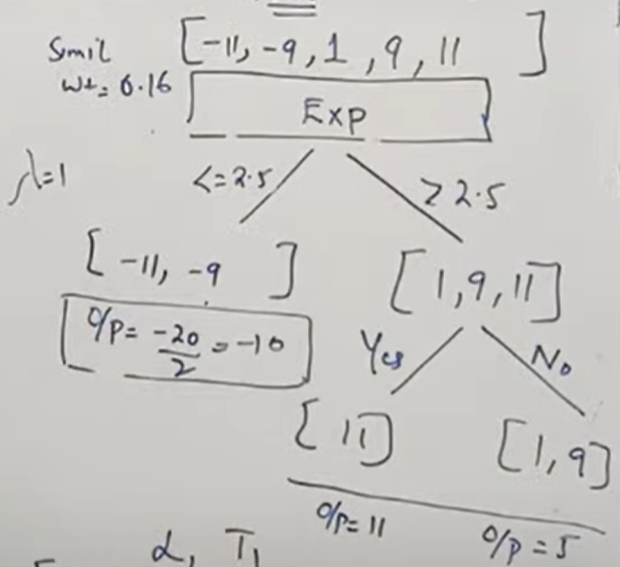

#### Test Data


Experience = 2 , Gap = Yes

First Base Model output will be 51 \
Learning Rate = 0.5
Output from the Above tree ( <2.5 = o/p =-10

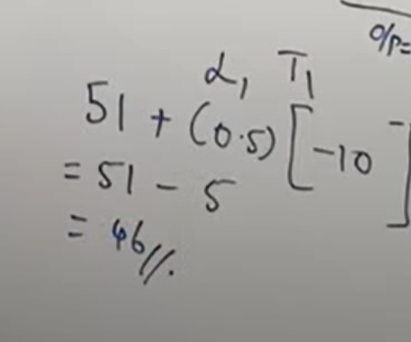

### Similarly we will calculate For all other values 

Then we will calculate Residual 2 , And again decison tree will be created

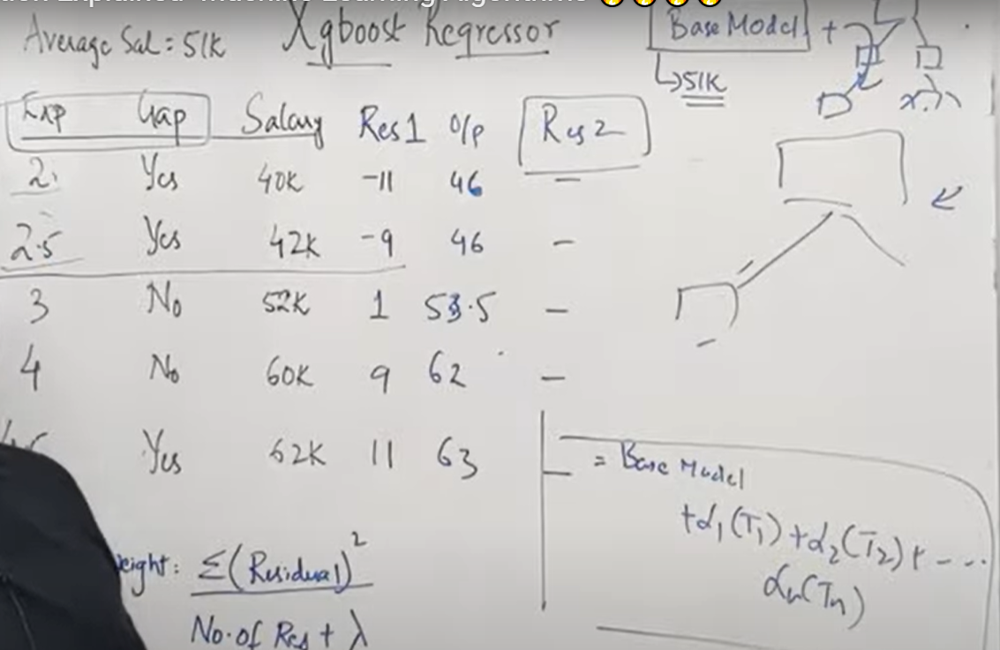

## T63 - Baye's Theorem - Conditional Probability 


1. Conditional Probability
2. Independent Events 
3. Dependent Events

### 1. Conditional Probability 

Probability of A given B = Probability of A intersection B / Probability of B

Suppose we have box , In which we have 5 marbles - 3 red,2 black , First we take 1 black marble.Probability of taking black marble is 2/5 , Again from remaining marbles if we take Probability of black marble then it will be 1/4 These is know as Probability of B where Event A has already be taken. Probability(B|A) = 1/4

P(A intersection B) - What is probability of A and B taking place = 2/5 * 1/4 = 1/10.

So above probability can only be told , If previous probabilities are calculated

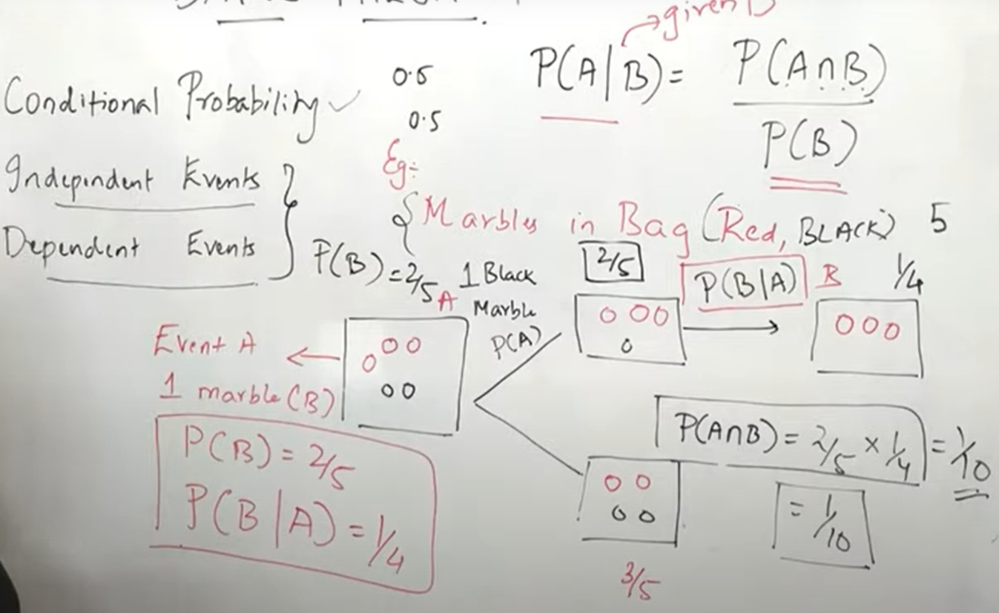

So these are Dependent Events 

###### Conditional Probability 

It says that we are trying to find out the probability of Event Given Another Event is already taken place in past.

### 2. Independent Events 

When we toss Indepedent Two coins, Both the output are independent to each other , They are not dependent

### 3. Dependent Events

Suppose we have box , In which we have 5 marbles - 3 red,2 black , First we take 1 black marble.Probability of taking black marble is 2/5 , Again from remaining marbles if we take Probability of black marble then it will be 1/4.
Probabilities are dependent on each other.


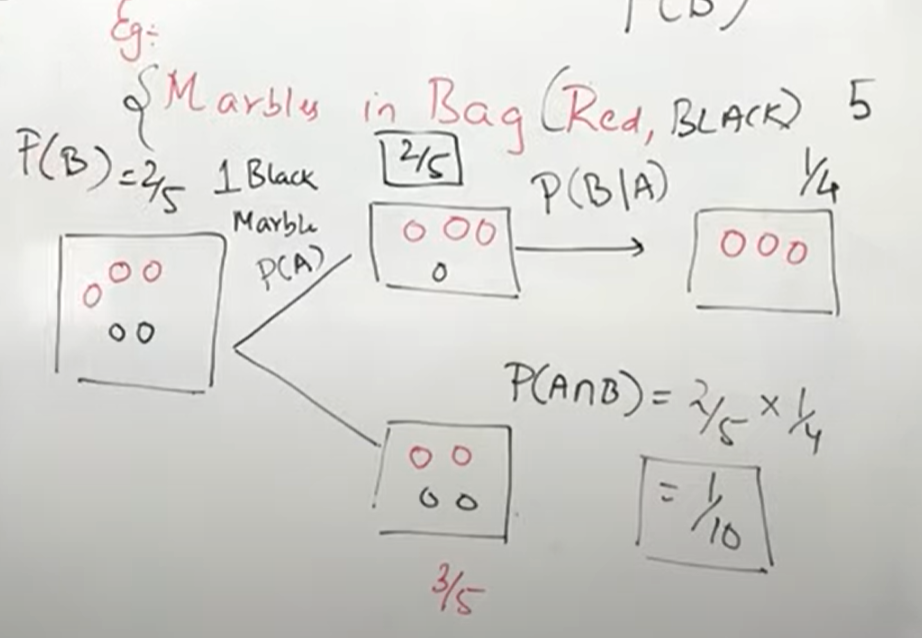

### BAYES Theorem 

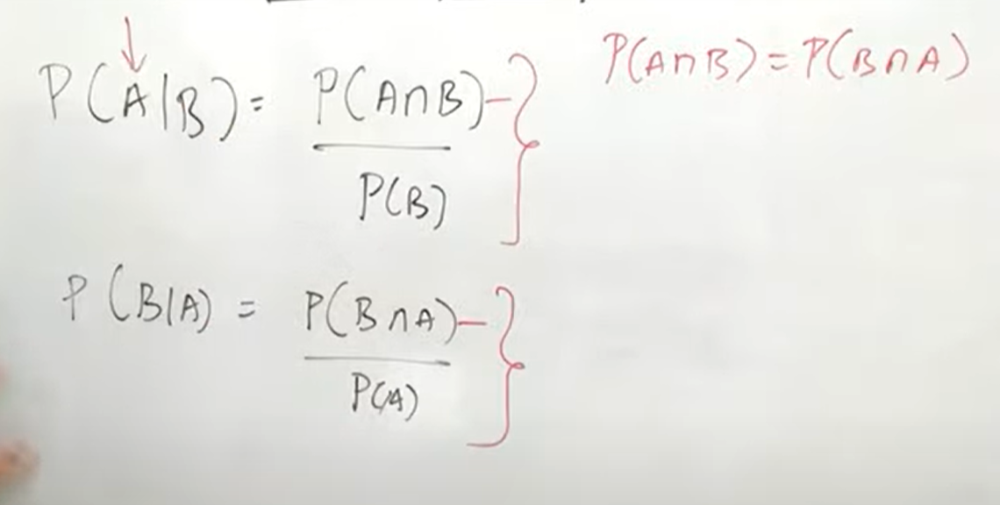

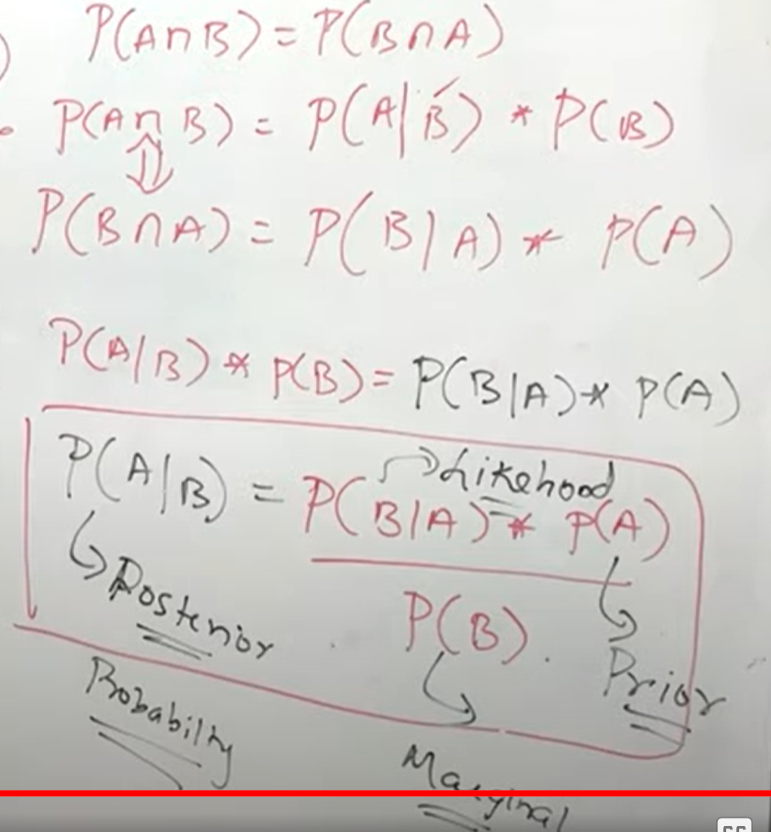

## T64 - Naive Baye's Classifier

Bayes Theorem

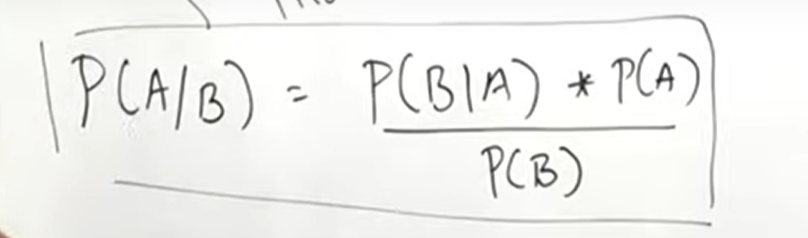

How Bayes Theorem Formula gets applied on Dataset

Dataset constains Independent Features (x1,x2,x3,x4...xn) and Dependent Feature (y)

A in Bayes Theorem gets replaced by Dependent Feature , B gets replaced by Independet Features

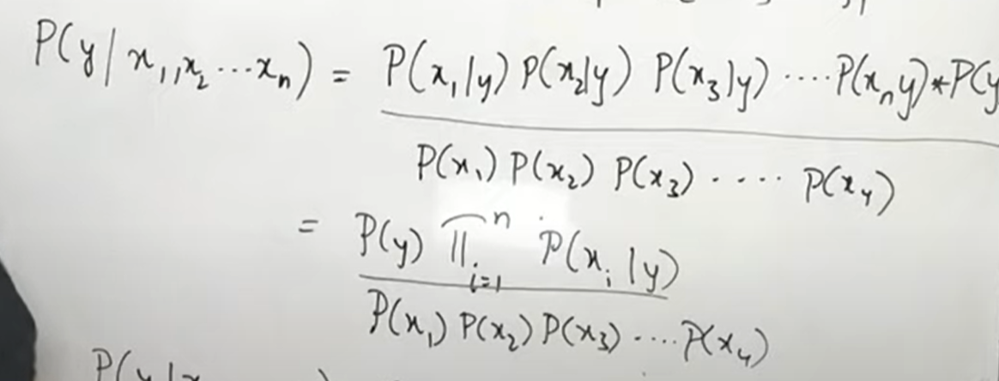

Left Hand value will be directly proportional to Right value which is above division

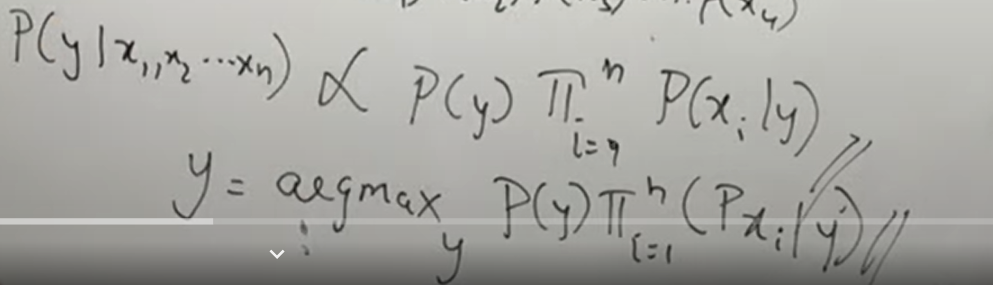

###### Now in order to find out the output of Independent features we need to take argmax .

Argmax - Yes - 0.7 , No - 0.3 --- We will consider Yes as output 

#### Example 

We have Outlook feature which contains three categories (Sunnt,Overcast,Rainy) , Temperature - (Hot,Mild,Cool) .Now based on these features we have to predict whether new data or row will play or not .

Suppose we have the below dataset with following features.

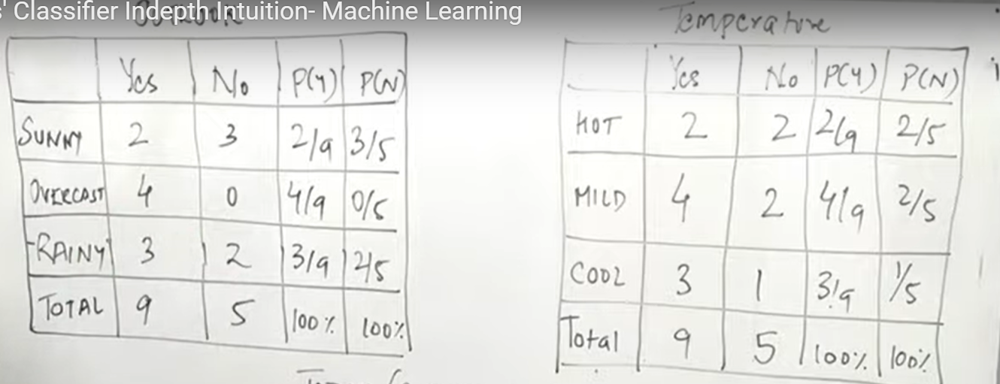

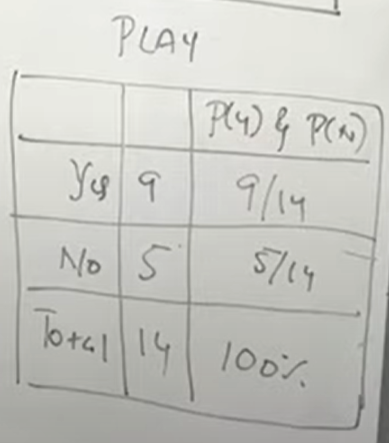

In Naive Bayes algorithm , Probability of each and every independent feature w.r.t to Dependent features is calculated.

So in above table you can see that Probability is calculated for each independent features w.r.t Dependent feature

Now we will see New Dataset (Sunny,Hot) , With these Independent features we will find the probability that whether person will play or not

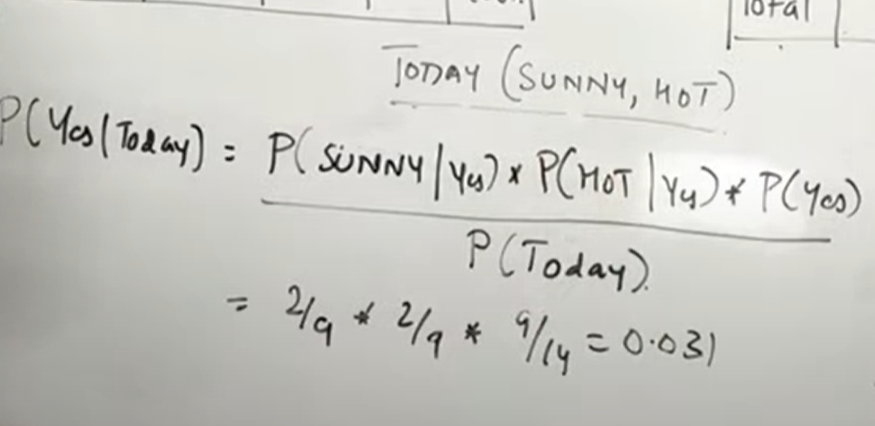

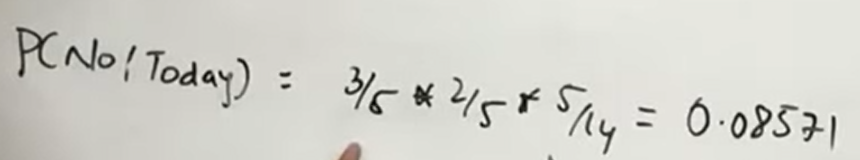

##### Now to get output i-e Probability(yes) and Probability(No) , we will normalize the values 

##### Normalization Formula  =  p(yes|today) / (p(yes|today) + p(no|today))

P(YES) = 0.27 \ 
P(NO) = 0.73 


Final value will be NO 

## T65 - Applying Naive Bayes on Text Data

Naive Bayes works well Text Data Classification

To work on Text Data , Various Text preprocessing is done to be classified .


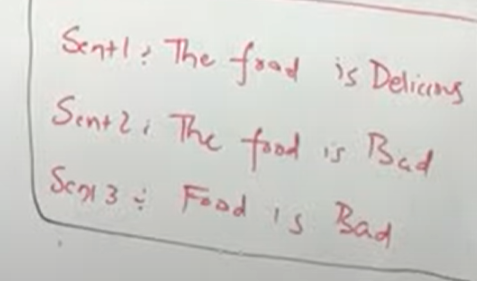

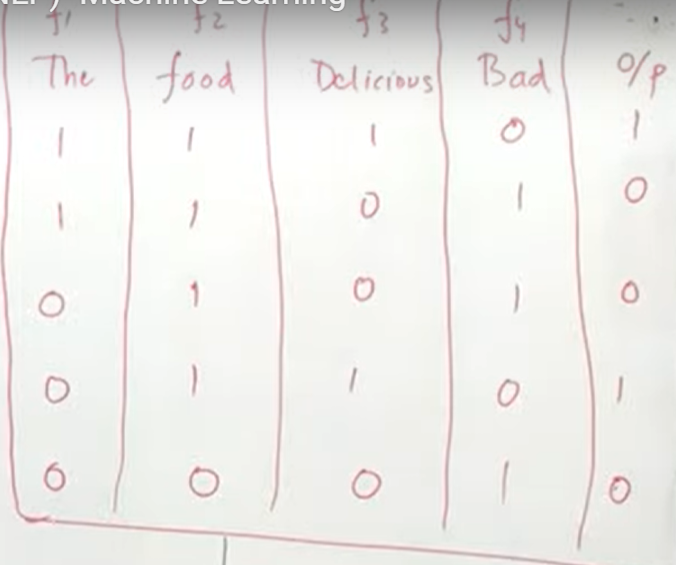

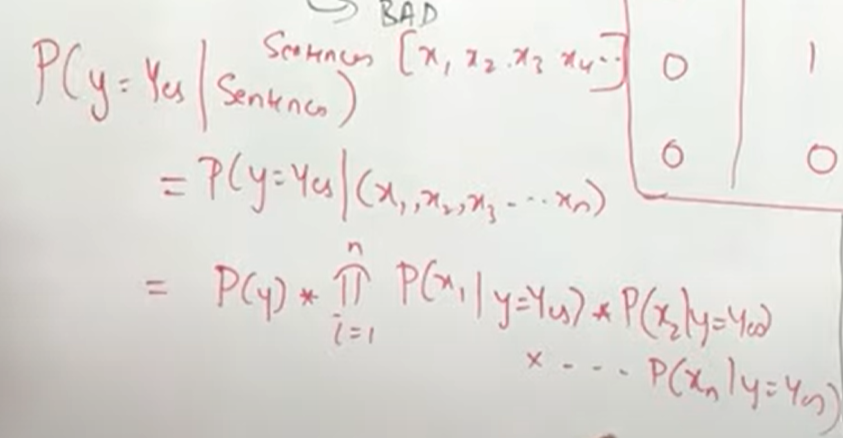

##### Now we will see -- 'The food is Delicious' Example 

Final value will be 0.1 not 0.01 , We will also calculate for P(no|features) .Then normalize values to get final output

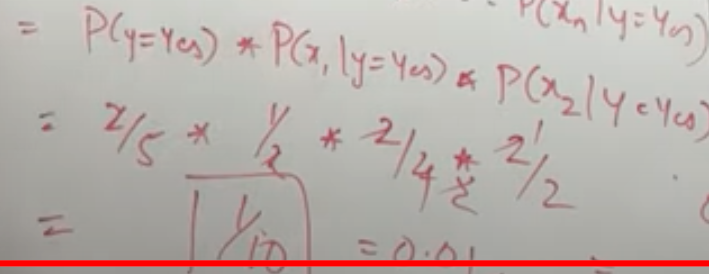

## T66 - Support Vector Machines (SVM - Intuition)

1. Support Vectors
2. Hyper planes
3. Marginal Distance 
4. Linearly Seperable
5. Non Linearly Seperable

SVM makes sure that when you are creating Hyperplane , Appart from that it also creates two Margin Lines , These two margin lines will have some distance .So that it will be easily seperable .

So when we have created First Hyperplane , We will create Two parallel Hyperplanes which will be passing to the one of the point of each category for each hyperplane.

One Hyperplane will go from one nearest Positive point from main hyperplane- Nearest Point to Marginace Dist - Support Vector 1 
Another Hyperplane will go from one nearest Negatice point from main hyperplane - Nearest pt to Marginal Dist - Spprt vec 2

Distance between Above two Hyperplanes is called MARGINAL DISTANCE

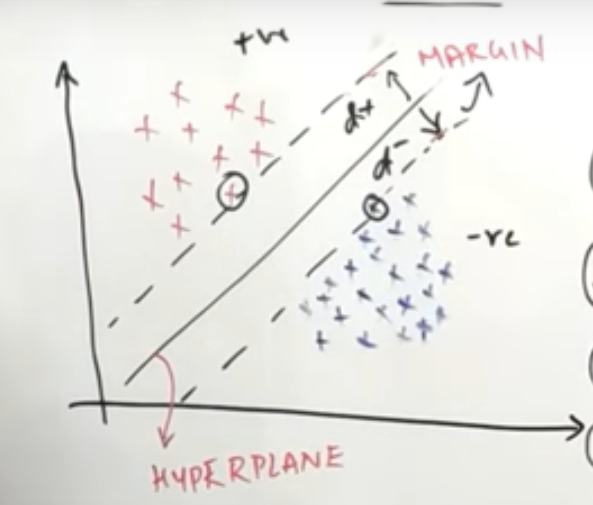

Now we have to create a Generalized model . These hyper planes help us to give better classification between negative and positive points.

So one question arises that we can create Multiple Hyperplanes ?

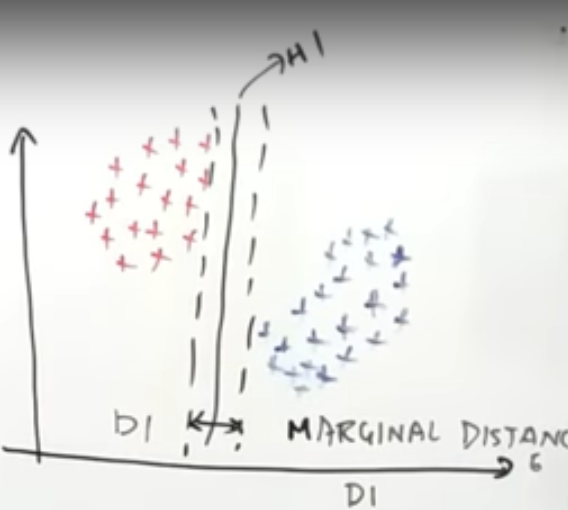

So when we create another hyperplanes , We also need to keep marginal distance in mind. \

We can see that there is very less marginal distance in above figure.

Our AIM in SVM is we have to maximize these MARGINAL DISTANCE

#### Above approach can only be used if Data is LINEARLY SEPERABLE 

#### For Non Linear Data - SVM kernels are used 

### T67 - SVM - PART 2

Consider below points that we have , And Hyperplane with equation given 

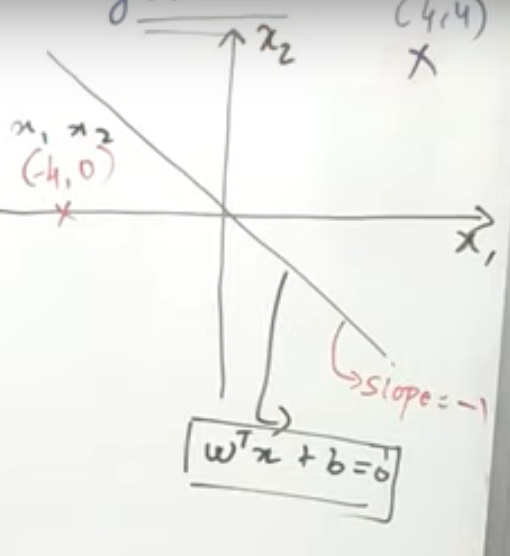

#### So for Red point (-4,0), How we will calculate y value ?

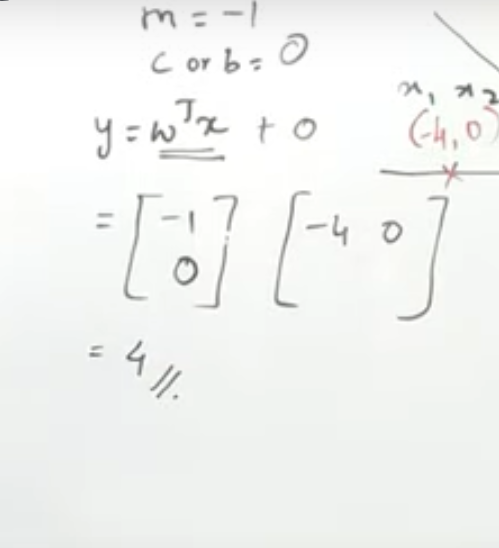

###### When any no of points are added near to above point , it will always be positive 

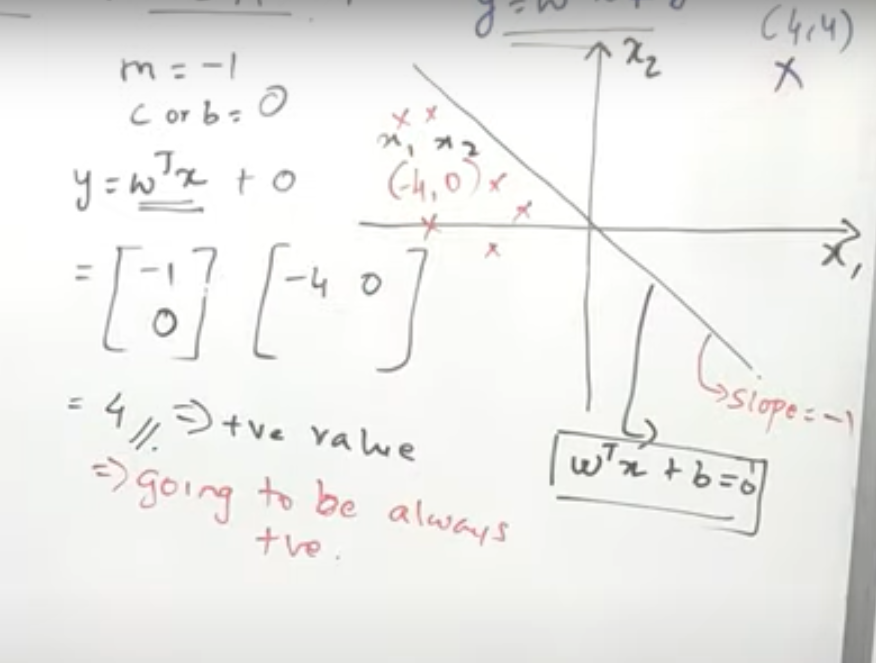

So any points below that hyperplane will be positive

##### Similarly we will calculate for another point as well

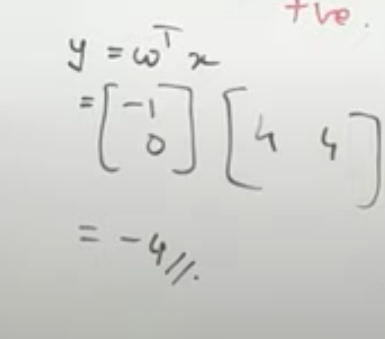

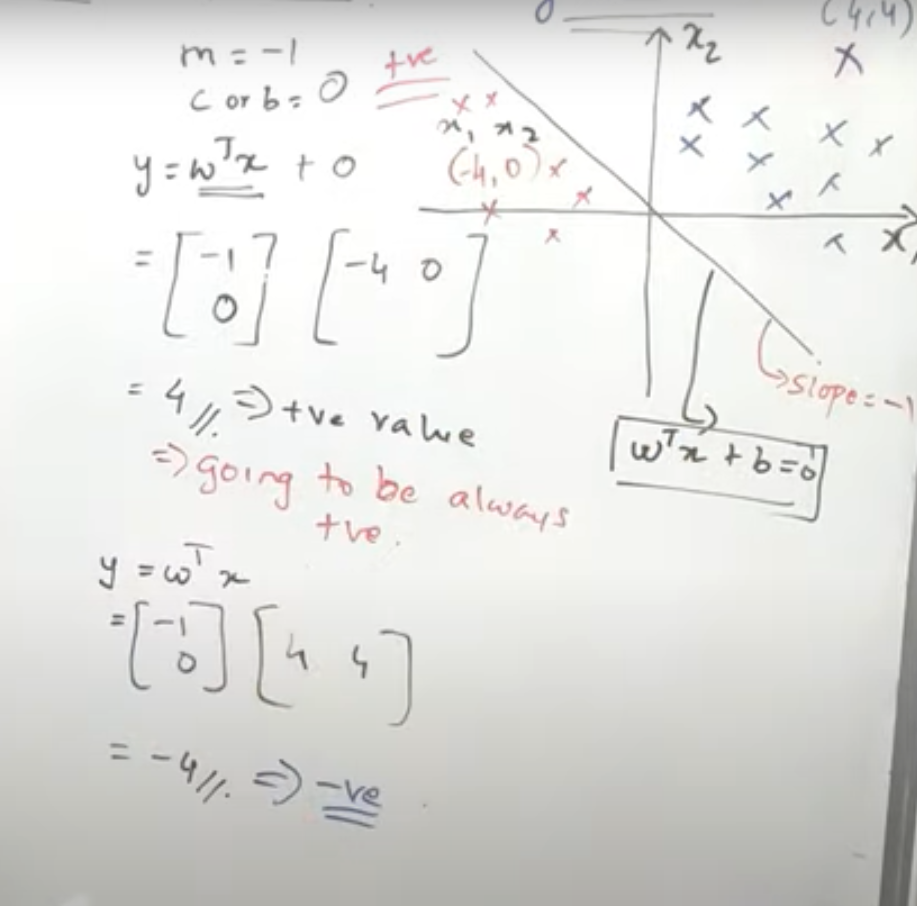

##### Now we will see it in SVM

Now from the hyperplace we will select nearest point towards negative and positive which will act as SUPPORT VECTORS

##### Two Hyperplanes will be drawn at Support vectors

+ve = +1 , -ve = -1

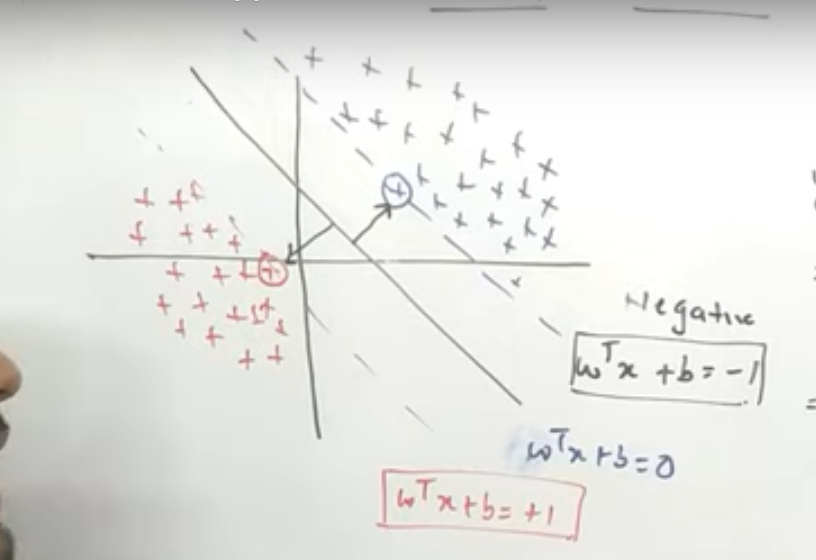

In above Two Hyperplanes there will be some b value . \
In SVM wherever the marginal distance is high we will select that main hyperplane.

We will calculate Marginal Distance now

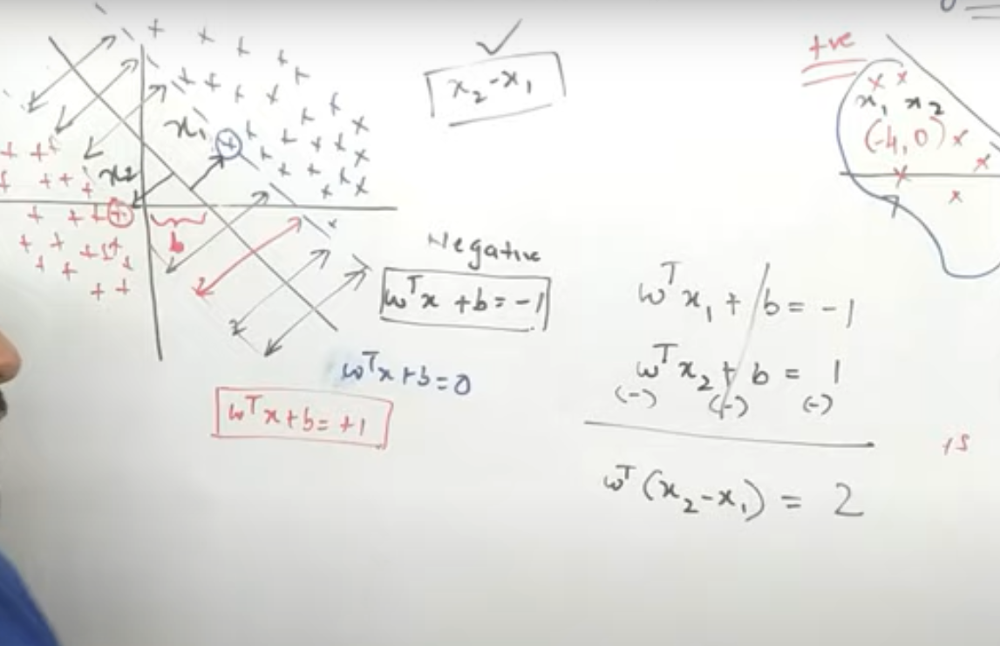

##### Now in above , we have to remove wt , We will use Norm

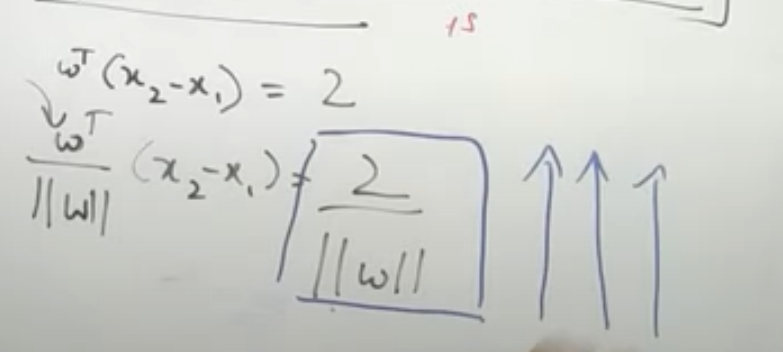

###### Optimization Function

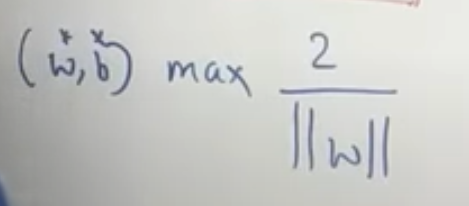

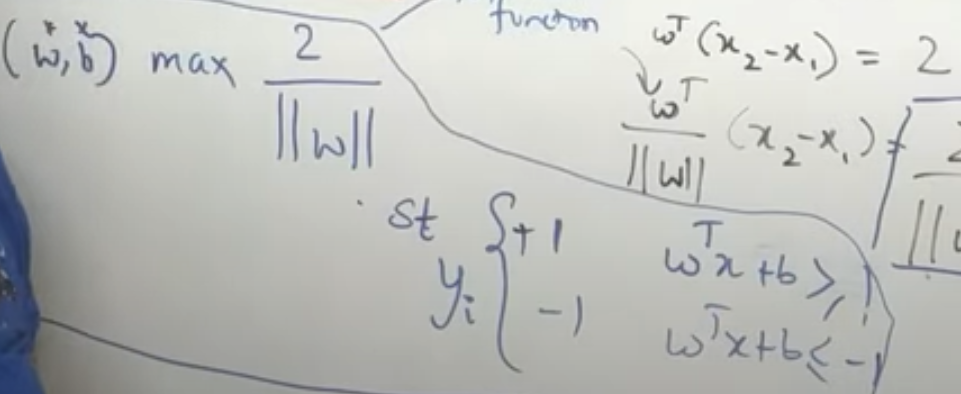

If it is not greater than 1 , then it is mis classification 

+ve * +ve = +ve \
-ve * -ve = +ve

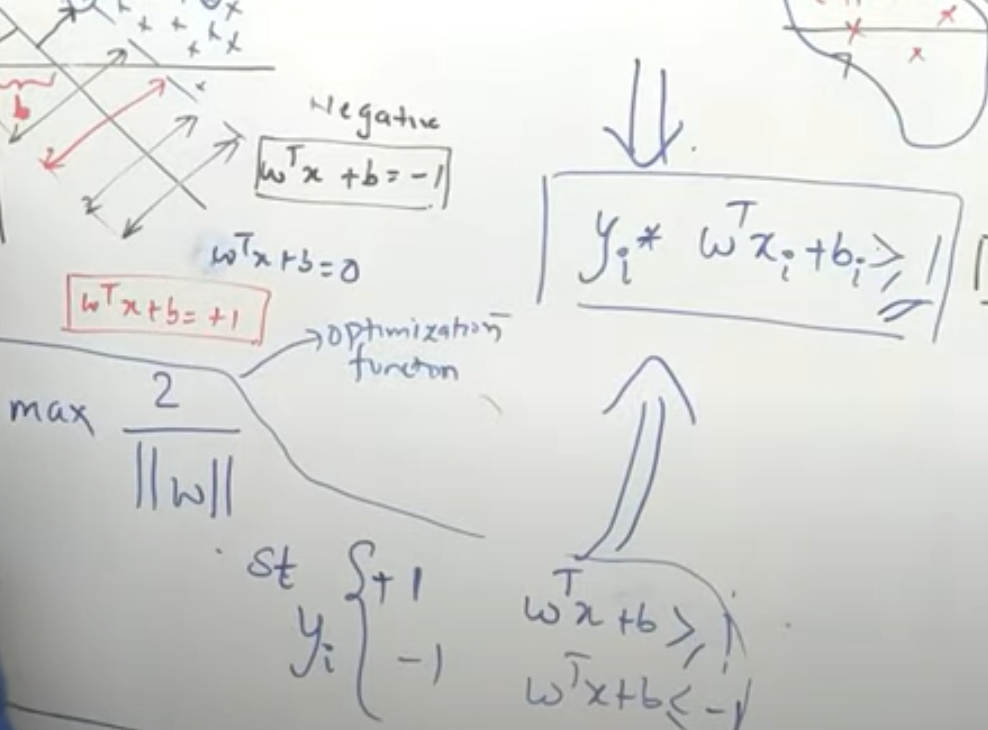

###### Above main optimized equation can also be written as 

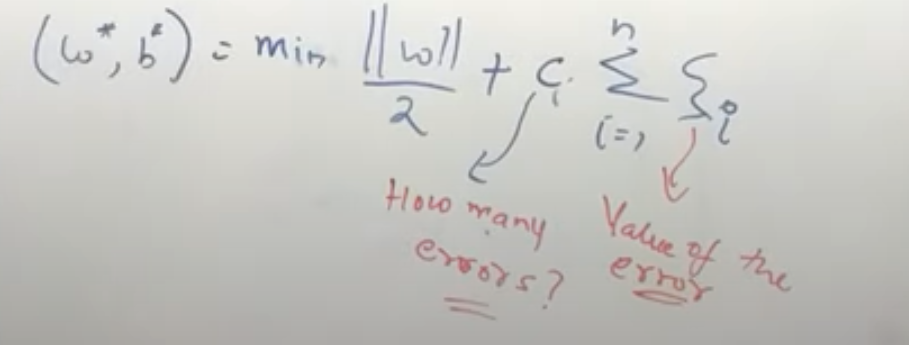

Error -- Regularization -- Points when mis classified while choosing Hyperplane

If it is 5 , Then even if it has 5 errors, we dont have to change the Hyperplane

Value of Error ---- Distance from its correct Hyperplane , We will do Sum and then Multiply it Regualrization value

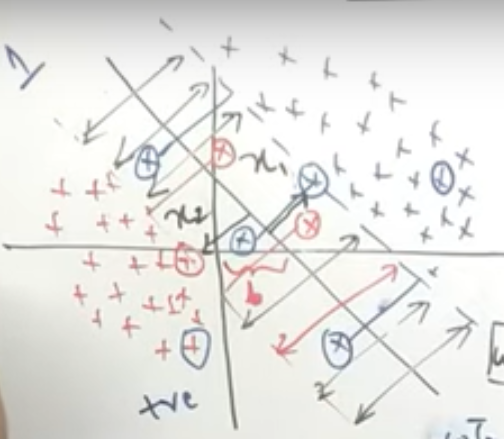

## T68 - How to find optimal threshold for Binary Classification


See Complete Machine Learning Practical Notebook

## T69 - What is Cross Validation and its types

We always do Train test split in ration of 70%-30% , So baset on testing data (30%) . We check the accuracy of model.Whenever Train Test split is done , 70% is radomly selected. So if there is no record similar to 30% in train , So when we do testing that record will not be able to predict correctly and our accuracy will get dropped.

When we select different random_States our accuracy will fluctuate. To overcome these Cross Validation is used

#### Cross Validation Types

#### 1. Leave One Out Cross Validation (LOOCV)

Take One as Testing dataset, Remaining as training dataset

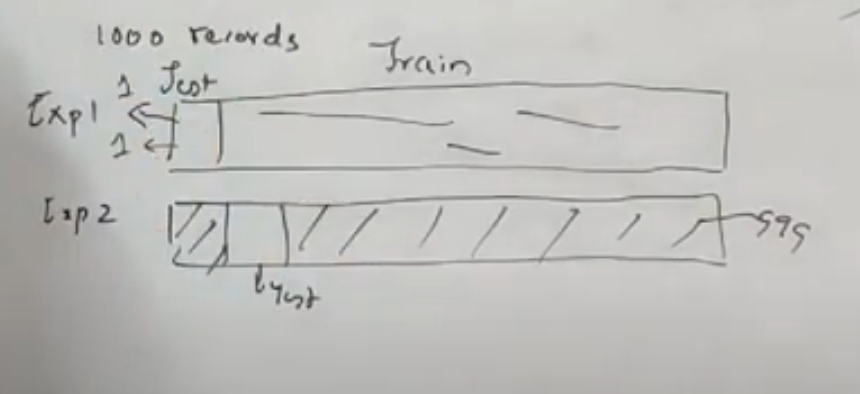

### 2.  K Fold Cross Validation

First K value is Selected - No of Times we will do different different splitting

K=5 \
1000/5 = 200 Records will be selected for Testing dataset

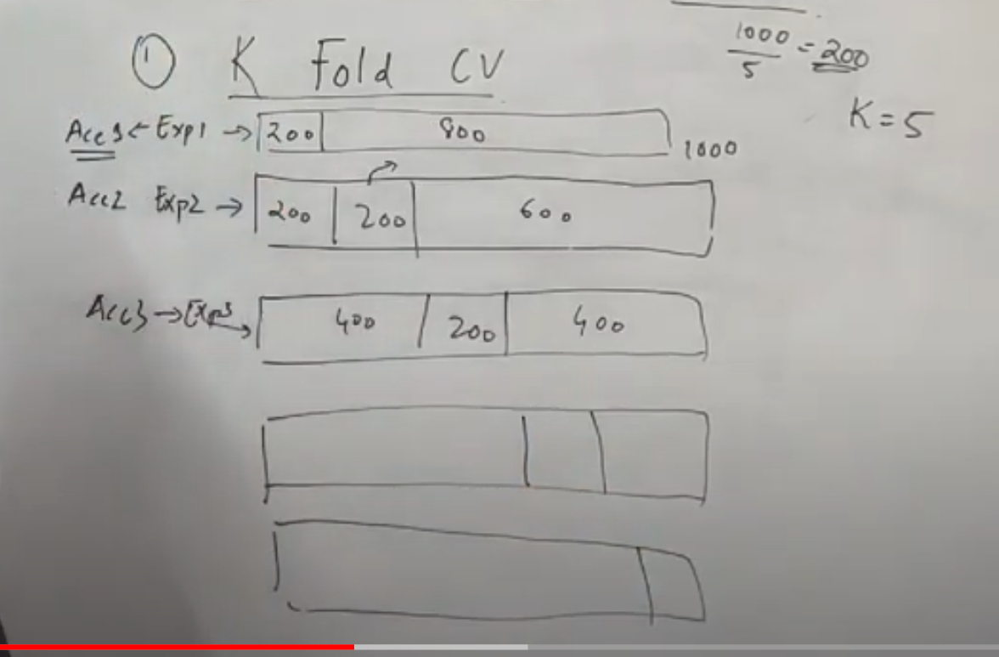

##### Disadvantages

When you select 200 , If there are records only of output '1' -- Imbalanced dataset . Inorder to overcome these we will use 

## 3. Stratified Cross Validation

It is similar to K fold cross validation , But Whenever Train and Testing data is selected , Stratified Cross validation makes sure that dataset is not Imbalanced in Train and Testing set . There will be good proportion of Each Class



### 4. Time Sereis Cross Validation 

In time series , We have dataset of Days - We have to do prediction of LAST TWO DAYS

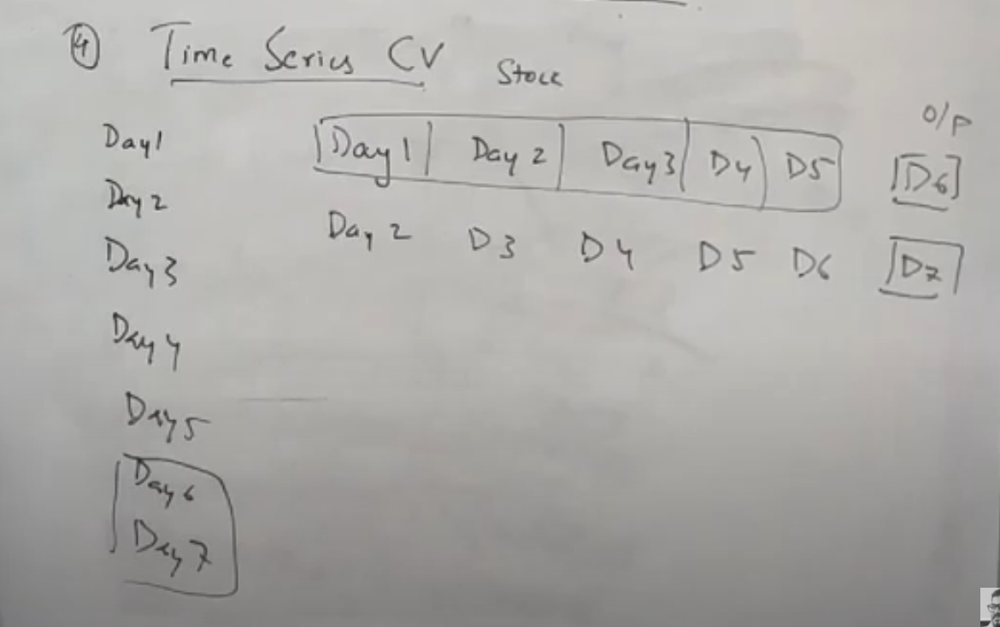

## T70 - Curse of Dimensionality

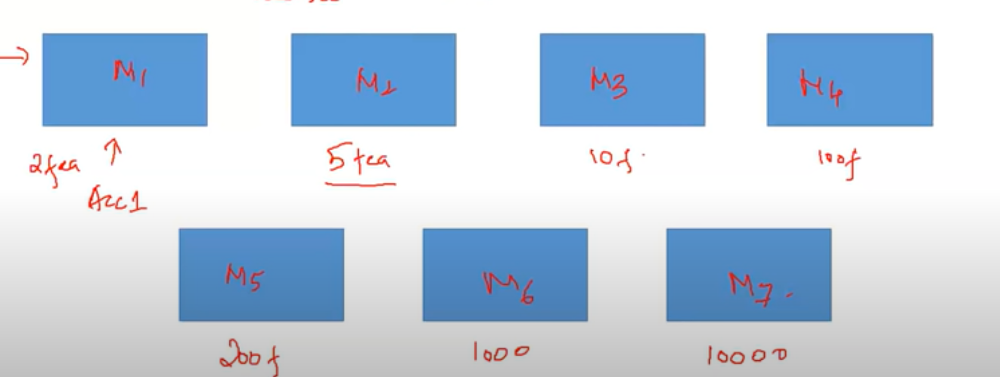

After a Threshold value , if we increase no of features , Our Accuracy starts decreasing.

i-e Model with 500 Features or 1000 features will not give good accuracy as compared to Model with 10,50,100 features



## T71 - PCA - Dimension Reduction

Complete Machine Learning Practical

## T72 - Clustering - K Means

It finds similarity between points and then group them into clusters

#### K Means

1. First we will find K Value (Centroid) k=2
2. Initializa two centroids at random
3. Now identify which points are near to both the centroids (Euclidean Distance can be used to find Nearest Points)
4. Select the groups (All points near each centroid) and Find Mean value 
5. Update the Centroids Position according to the mean value
6. Do above steps again and again untill the mean value is same for previous and current step


#### Selecting K value - Using Elbow Method

Now we will run a Loop for k=1 to 20 . Now based on WCSSC (Within Cluster Sum of Square - Distance between Centroid and Sum of all points Summation of i=1 to n(ci+ xi)**2) 

So for smaller k value - WCSS will be High, When K value increases , WCSS decreases . And after some threshold value it will be constant

## T73 - Hierarchical Clustering - It saves grouping History via Dendogram)

1. Each and Every points are assumed as Different clusters 
2. Two Nearest Clusters are grouped 
3. As we combines , History of grouping gets saved 

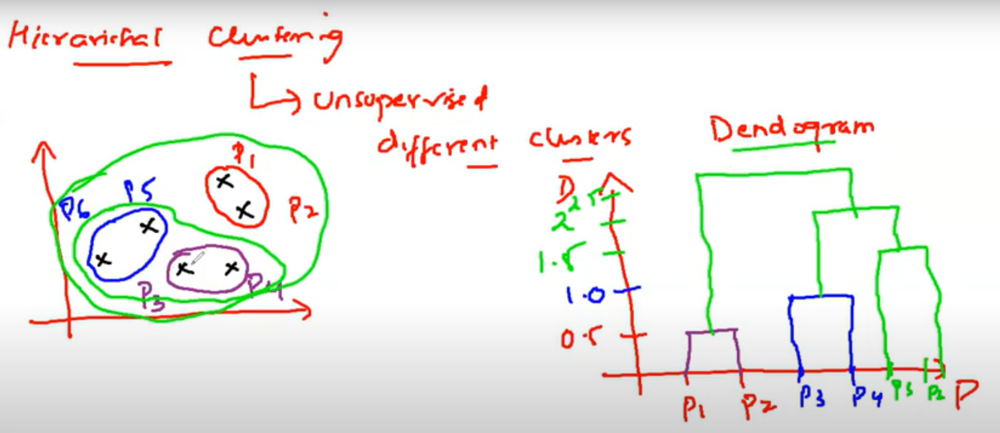

#### What is exact no of clusters we should use ?

We have to find Longest Vertical line , such that no horizontal line gets intersect.From Below figure you can see Line between 2 and 2.5 is lonogest vertical line , We will select that line and Draw perpendicular line in center of that line and see how many interesections are created . 2 Clusters are created

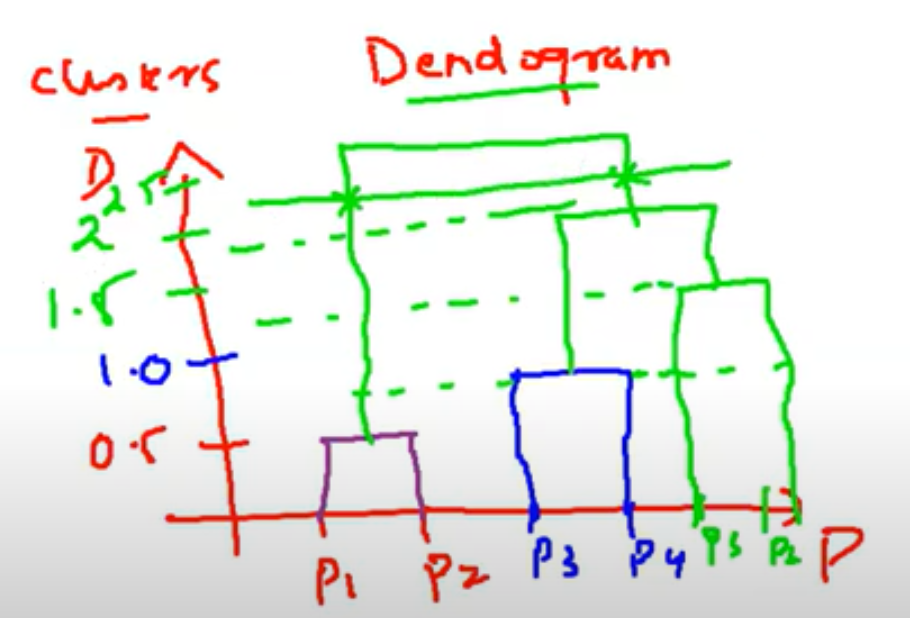

## T74 - Density Based Spatial Clustering of Applications with Noise (DBSCAN)

Important Terminologies
1. Epsilon - Create a radius of epsilon value from a given point
2. Min points - Consider Minpoints value (4) - 4 Points should be there in circle created by epsilon value
3. Core points - Point from which Radius is created or Center of circle
4. Border Points - If a point doesnt satisfy the MinPoints condition , But one core point is present in circle
5. Noise points - Outlier (Does not satisfy min point condition , border point condition etc

Circle with core point is Cluster

Initially we consider some Epsilon and Minpoints values 

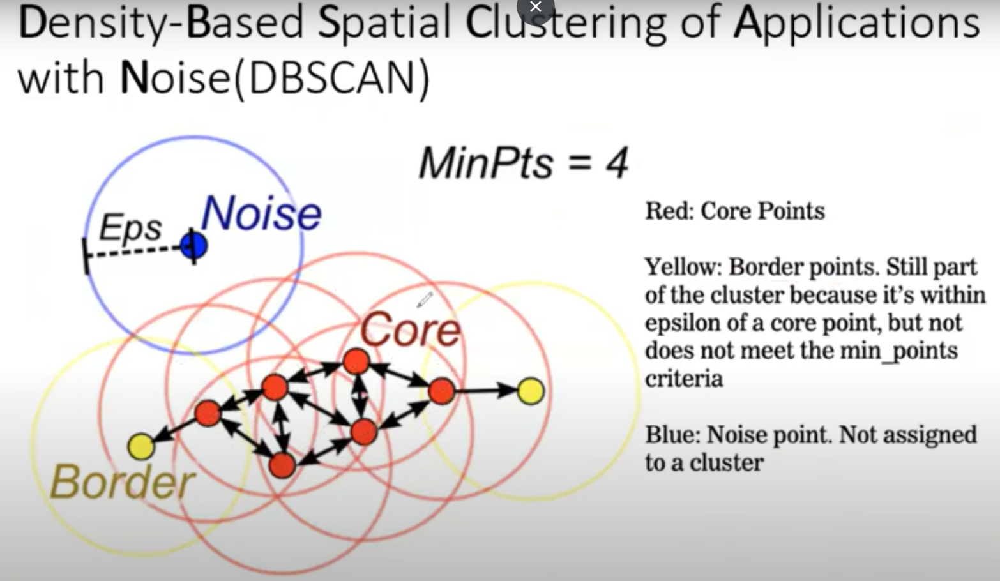

#### Advantages of DBSCAN over K MEANS

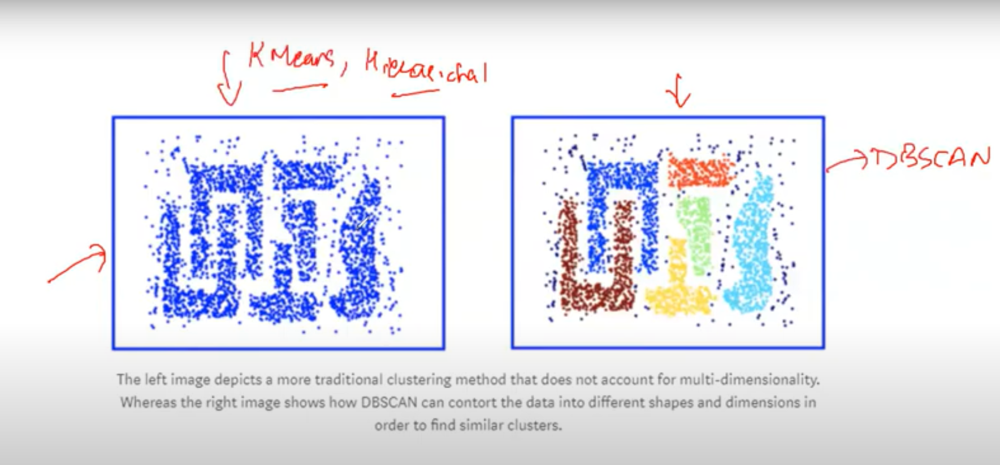

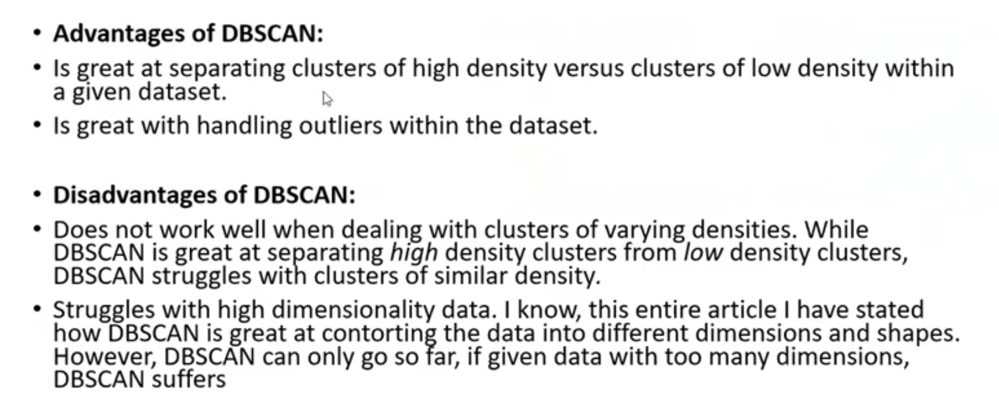

See Machine Learning Practical Notebook for DBSCAN Implementation

## 75 - Silhouette Clustering - Validating Clustering Models

As we know when we select value of K from Elbow method , How we should validate that these value is optimal to select

### Silhouette Clustering

#### Step 1

Within the cluster , We will take one data point and then we will find distance from selected datapoint(i) to the remaining datapoints (j) ----- These step can be denoted as Computing 'ai'.Similarly we will do for all points within that cluster

#### Step 2

From One point of One cluster , It will calculate the distance between all points of another cluster to the one point of First cluster.Similarly we will compute for all point in First Cluster. These step will be denoted by 'bi'

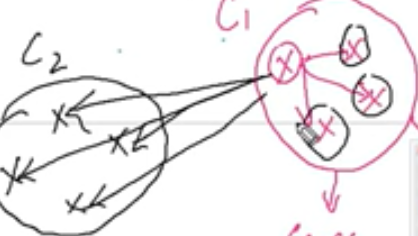

#### Step 3 

If ai < bi ---- Clustering is Done properly
If ai > bi ----- Clustering is Not Done properly


Silhouette Value will be between -1 to +1

Value Towards 1 --- Clusteing Done propery
Value towards -1 ---Clustering Not Done properly

https://en.wikipedia.org/wiki/Silhouette_(clustering)#:~:text=The%20silhouette%20value%20is%20a,poorly%20matched%20to%20neighboring%20clusters